# MIDTERM

## VERI YUKLEME

Bu dersin arasınavında , [ChestX-ray8 dataset](https://arxiv.org/abs/1705.02315) veri seti'nden alınan göğüs röntgeni görüntüleriyle çalışacaksınız.
<img src="https://raw.githubusercontent.com/hardik0/AI-for-Medicine-Specialization/master/AI-for-Medical-Diagnosis/Week-1/xray-image.png" alt="U-net Image" width="300" align="middle"/>



In [1]:
# Import necessary packages
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import os
import seaborn as sns
sns.set()

In [2]:
!git clone https://github.com/hardik0/AI-for-Medicine-Specialization
%cd AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis/

Cloning into 'AI-for-Medicine-Specialization'...
remote: Enumerating objects: 1601, done.
remote: Counting objects: 100% (28/28), done.
remote: Compressing objects: 100% (28/28), done.
remote: Total 1601 (delta 9), reused 2 (delta 0), pack-reused 1573 (from 1)
Receiving objects: 100% (1601/1601), 720.36 MiB | 15.88 MiB/s, done.
Resolving deltas: 100% (30/30), done.
Updating files: 100% (1497/1497), done.
/content/AI-for-Medicine-Specialization/AI-for-Medical-Diagnosis


In [3]:
%ls nih/

densenet.hdf5  images_small/  pretrained_model.h5  test.csv  train-small.csv  valid-small.csv


In [4]:
# Read csv file containing training datadata
train_df = pd.read_csv("nih/train-small.csv")
# Print first 5 rows
print(f'There are {train_df.shape[0]} rows and {train_df.shape[1]} columns in this data frame')
train_df.head()

There are 1000 rows and 16 columns in this data frame


,Image,Atelectasis,Cardiomegaly,Consolidation,Edema,Effusion,Emphysema,Fibrosis,Hernia,Infiltration,Mass,Nodule,PatientId,Pleural_Thickening,Pneumonia,Pneumothorax
0,00008270_015.png,0,0,0,0,0,0,0,0,0,0,0,8270,0,0,0
1,00029855_001.png,1,0,0,0,1,0,0,0,1,0,0,29855,0,0,0
2,00001297_000.png,0,0,0,0,0,0,0,0,0,0,0,1297,1,0,0
3,00012359_002.png,0,0,0,0,0,0,0,0,0,0,0,12359,0,0,0
4,00017951_001.png,0,0,0,0,0,0,0,0,1,0,0,17951,0,0,0


Have a look at the various columns in this csv file. The file contains the names of chest x-ray images ("Image" column) and the columns filled with ones and zeros identify which diagnoses were given based on each x-ray image.

### Data types and null values check
Run the next cell to explore the data types present in each column and whether any null values exist in the data.

In [5]:
# Look at the data type of each column and whether null values are present
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 16 columns):
 #   Column              Non-Null Count  Dtype 
---  ------              --------------  ----- 
 0   Image               1000 non-null   object
 1   Atelectasis         1000 non-null   int64 
 2   Cardiomegaly        1000 non-null   int64 
 3   Consolidation       1000 non-null   int64 
 4   Edema               1000 non-null   int64 
 5   Effusion            1000 non-null   int64 
 6   Emphysema           1000 non-null   int64 
 7   Fibrosis            1000 non-null   int64 
 8   Hernia              1000 non-null   int64 
 9   Infiltration        1000 non-null   int64 
 10  Mass                1000 non-null   int64 
 11  Nodule              1000 non-null   int64 
 12  PatientId           1000 non-null   int64 
 13  Pleural_Thickening  1000 non-null   int64 
 14  Pneumonia           1000 non-null   int64 
 15  Pneumothorax        1000 non-null   int64 
dtypes: int64(15), object(1)
m

### Unique IDs check
"PatientId" has an identification number for each patient. One thing you'd like to know about a medical dataset like this is if you're looking at repeated data for certain patients or whether each image represents a different person.

In [6]:
print(f"The total patient ids are {train_df['PatientId'].count()}, from those the unique ids are {train_df['PatientId'].value_counts().shape[0]} ")

The total patient ids are 1000, from those the unique ids are 928 


As you can see, the number of unique patients in the dataset is less than the total number so there must be some overlap. For patients with multiple records, you'll want to make sure they do not show up in both training and test sets in order to avoid data leakage (covered later in this week's lectures).

### Explore data labels
Run the next two code cells to create a list of the names of each patient condition or disease.

In [7]:
columns = train_df.keys()
columns = list(columns)
print(columns)

['Image', 'Atelectasis', 'Cardiomegaly', 'Consolidation', 'Edema', 'Effusion', 'Emphysema', 'Fibrosis', 'Hernia', 'Infiltration', 'Mass', 'Nodule', 'PatientId', 'Pleural_Thickening', 'Pneumonia', 'Pneumothorax']


In [8]:
# Remove unnecesary elements
columns.remove('Image')
columns.remove('PatientId')
# Get the total classes
print(f"There are {len(columns)} columns of labels for these conditions: {columns}")

There are 14 columns of labels for these conditions: ['Atelectasis', 'Cardiomegaly', 'Consolidation', 'Edema', 'Effusion', 'Emphysema', 'Fibrosis', 'Hernia', 'Infiltration', 'Mass', 'Nodule', 'Pleural_Thickening', 'Pneumonia', 'Pneumothorax']


Run the next cell to print out the number of positive labels (1's) for each condition

In [9]:
# Print out the number of positive labels for each class
for column in columns:
    print(f"The class {column} has {train_df[column].sum()} samples")

The class Atelectasis has 106 samples
The class Cardiomegaly has 20 samples
The class Consolidation has 33 samples
The class Edema has 16 samples
The class Effusion has 128 samples
The class Emphysema has 13 samples
The class Fibrosis has 14 samples
The class Hernia has 2 samples
The class Infiltration has 175 samples
The class Mass has 45 samples
The class Nodule has 54 samples
The class Pleural_Thickening has 21 samples
The class Pneumonia has 10 samples
The class Pneumothorax has 38 samples


Have a look at the counts for the labels in each class above. Does this look like a balanced dataset?

### Data Visualization
Using the image names listed in the csv file, you can retrieve the image associated with each row of data in your dataframe.

Run the cell below to visualize a random selection of images from the dataset.

Display Random Images


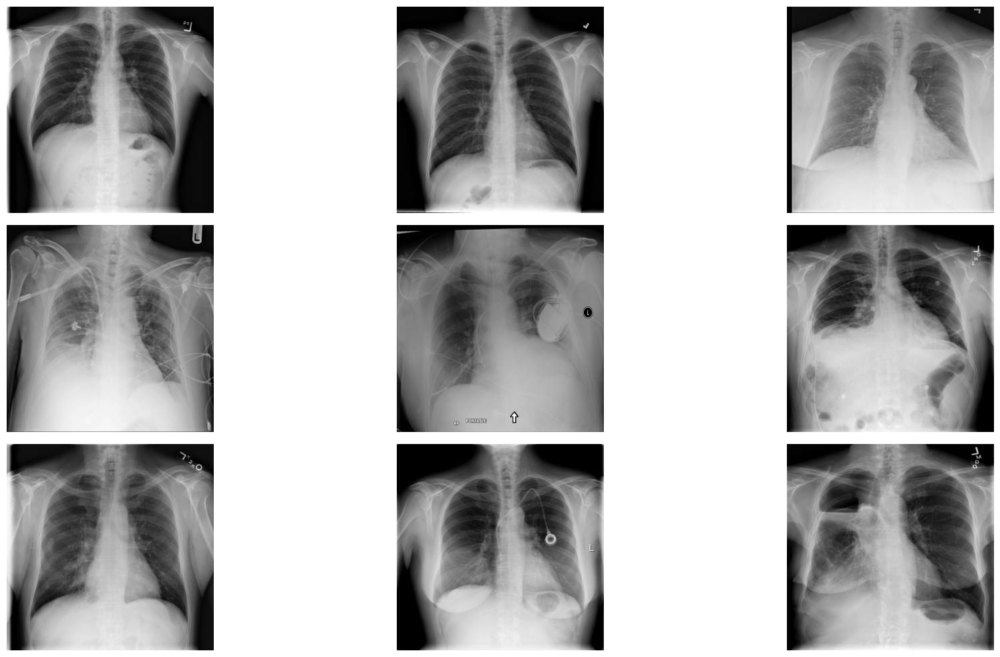

In [10]:
# Extract numpy values from Image column in data frame
images = train_df['Image'].values

# Extract 9 random images from it
# Sabit random sonuçlar için seed değeri
np.random.seed(42)

# 9 rastgele görsel seçimi
random_images = [np.random.choice(images) for i in range(9)]
#random_images = [np.random.choice(images) for i in range(9)]

# Location of the image dir
img_dir = 'nih/images_small/'

print('Display Random Images')

# Adjust the size of your images
plt.figure(figsize=(20,10))

# Iterate and plot random images
for i in range(9):
    plt.subplot(3, 3, i + 1)
    img = plt.imread(os.path.join(img_dir, random_images[i]))
    plt.imshow(img, cmap='gray')
    plt.axis('off')

# Adjust subplot parameters to give specified padding
plt.tight_layout()

** RASTGELE SECİLMİŞ 9 GÖRÜNTÜNÜN ISTATISTIKSEL ÖZELLİKLERİNİ (MAKSIMUM, MINIMUM, MEAN VE STD) HESAPLAYIN. ORNEK OLARAK BIR GORUNTU ICIN HESAPLAMA YAPILMISTIR

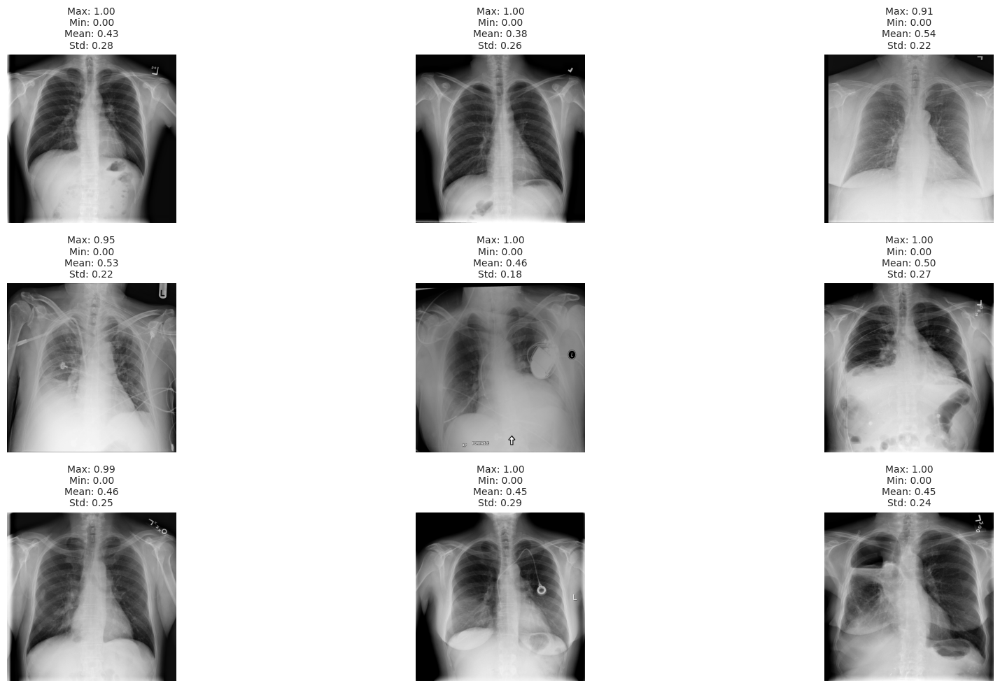

In [11]:

plt.figure(figsize=(20, 10))

# Her bir görüntü için maksimum, minimum, ortalama ve standart sapma değerlerini hesaplayın ve gösterin
for i in range(9):
    plt.subplot(3, 3, i + 1)

    # Görüntüyü yükleyin ve gösterin
    img = plt.imread(os.path.join(img_dir, random_images[i]))
    plt.imshow(img, cmap='gray')
    plt.axis('off')

    # Görüntü için istatistikleri hesaplayın
    img_max = img.max()
    img_min = img.min()
    img_mean = img.mean()
    img_std = img.std()

    # Alt kısımda hesaplanan değerleri gösterin
    plt.title(f'Max: {img_max:.2f}\nMin: {img_min:.2f}\nMean: {img_mean:.2f}\nStd: {img_std:.2f}', fontsize=10)

plt.tight_layout()
plt.show()

Minimum değerin 0.0 olması, görüntüde tamamen siyah alanlar olduğu anlamına gelir, hava veya düşük yoğunluklu dokuları ifade edebilir.

Maksimum değerin 1.0 olması, görüntüde tamamen beyaz alanlar olduğunu gösterir. Bu, genellikle kemiklerin veya yoğun dokuların yer aldığı bölgelerdir.

İlk satırdaki fotoğrafların ortalama mean değeri 60'dan yüksek olması X-ray görüntüsünün büyük bir kısmının parlak tonlarda olduğunu, yani yoğun dokuların baskın olduğunu gösterir.

Standart sapmanın düşük olması, görüntüde daha düşük kontrast olduğunu ve gri tonların daha baskın olduğunu gösterir. Bu, görüntünün tüm piksel değerlerinin birbirine yakın olduğu ve net bir ayrımın olmadığı anlamına gelebilir.

8. Fotoğraf için
Maksimum değerin 0.73 olması, görüntüde tamamen beyaz alanlar olmadığını gösterir; en parlak bölge bile tam beyaz (1.0) değildir, yalnızca açık gri tonlarındadır.
Bu durum, görüntüde yüksek yoğunluklu dokuların (örneğin kemikler gibi) tam anlamıyla aydınlık olarak yansımadığını, dolayısıyla biraz daha düşük kontrasta sahip olduğunu gösterir.

Minimum değerin 0.01 olması, görüntüde tamamen siyah alanların (0.0) olmadığını ancak çok koyu gri alanların bulunduğunu gösterir.
Bu, akciğer gibi boşluklu alanların tam siyah olarak değil, koyu gri tonlarında göründüğünü ima eder. Görüntüdeki boşluklar ya da düşük yoğunluklu dokular biraz daha parlak bir şekilde yansıtılmış olabilir.

Ortalama değerin 0.41 olması, görüntünün genel olarak orta derecede koyu olduğunu, yani parlak alanların oranının düşük olduğunu gösterir.
Bu değer, görüntüde gri tonların ağırlıklı olduğunu ve açık ya da parlak alanların nispeten az olduğunu gösterir. Görüntü genel olarak koyu ya da orta gri tonlarda olabilir.
Bu değer, düşük kontrastlı bir X-ray’i işaret edebilir; yani, doku farklılıklarının net olarak ayrışmaması olasıdır.

Standart sapma değeri 0.15, piksel yoğunluklarının birbirine yakın olduğunu ve görüntüde çok fazla kontrast olmadığını gösterir.
Düşük bir standart sapma, koyu ve açık alanlar arasında belirgin bir ayrımın olmadığını ifade eder; bu da X-ray’deki farklı dokuların (örneğin kemik ve yumuşak doku gibi) net olarak ayırt edilmesini zorlaştırabilir.


RASTGELE SECILMIS 9 GORUNTUNUN HISTOGRAMINI CIZDIRIN. ORNEK OLARAK BIR GORUNTU ICIN VERILMISTIR.

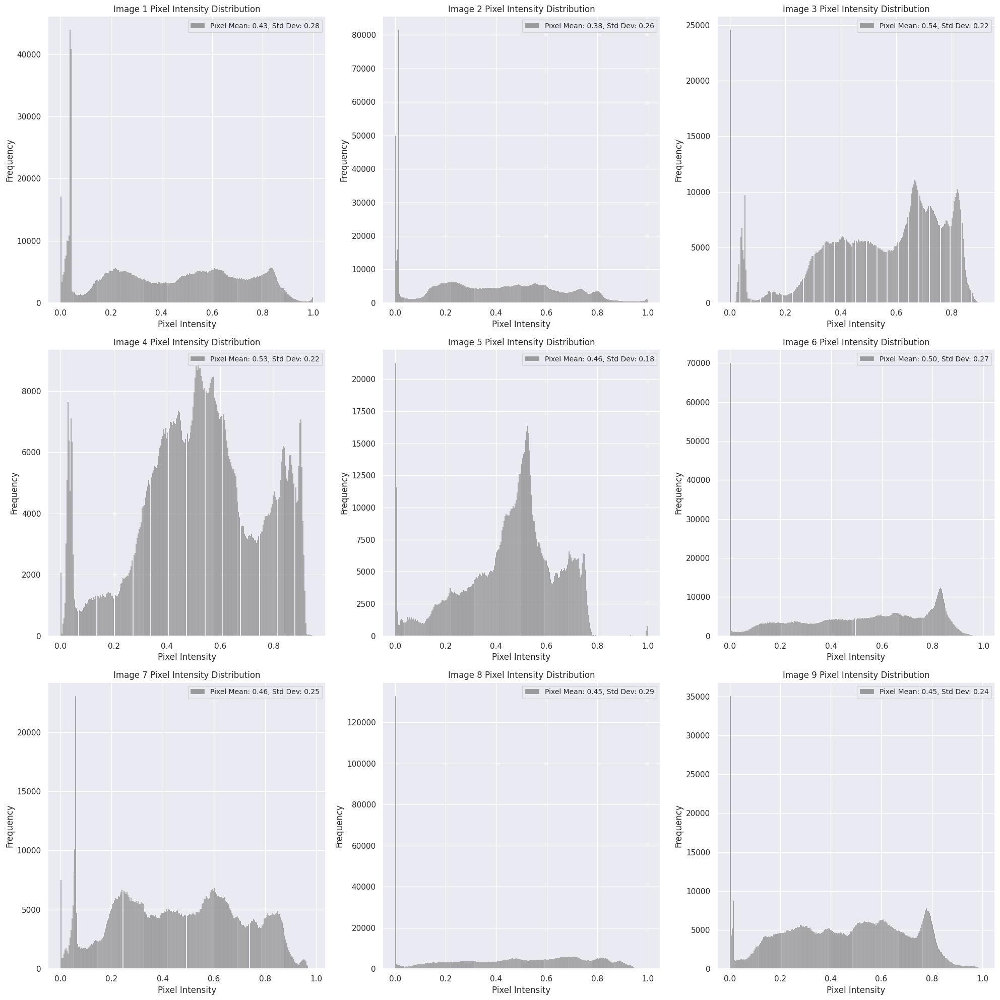

In [12]:
plt.figure(figsize=(20, 20))

# 9 resim için histogram oluşturma
for i in range(9):
    img_path = os.path.join(img_dir, random_images[i])
    raw_image = plt.imread(img_path)

    plt.subplot(3, 3, i + 1)
    sns.histplot(raw_image.ravel(), bins=256, color='gray', kde=False,
                 label=f'Pixel Mean: {np.mean(raw_image):.2f}, Std Dev: {np.std(raw_image):.2f}')

    plt.legend(loc='upper right', fontsize=10)
    plt.title(f'Image {i+1} Pixel Intensity Distribution')
    plt.xlabel('Pixel Intensity')
    plt.ylabel('Frequency')

plt.tight_layout()
plt.show()

Image 1:

Grafikte belirgin iki tepe noktası var, bu da görüntünün çeşitli parlaklık seviyelerine sahip olduğunu gösteriyor.


Image 2:

Geniş bir parlaklık dağılımı olduğu, ancak yoğunluğun çoğunun orta seviyelerde toplandığı görülüyor.

Image 3:

Bu görüntü, büyük oranda orta parlaklık değerlerine sahip.

Image 4:

Parlaklık değerlerinin düşük ve orta seviyelerde yoğunlaştığını gösteriyor.

Image 5:

Farklı parlaklık seviyelerinde piksellere sahip ve daha geniş bir parlaklık yelpazesi var.

Image 6:


Grafikte 0.0-0.1 aralığında düşük yoğunlukta bir tepe noktası bulunuyor.
Parlaklık değerleri düşük ve orta seviyelerde yoğunlaşmış.

Image 7:


Parlaklık değerleri geniş bir alana yayılmış, ancak özellikle düşük yoğunluklarda yüksek frekans var.
Görüntüde koyu ve orta tonlar hakim.

Image 8:

Histogramın sağ tarafında (0.5 civarı) yoğun bir tepe var, düşük ve orta seviyelerde daha homojen.
Bu görüntüde de düşük ve orta parlaklıklar öne çıkıyor.

Image 9:

Dağılım daha yayılmış, ancak 0.4-0.7 aralığında yoğunlaşmış.


GORUNTULERE CONTRAST STRECTCHING YAPINIZ, CONTRAST STRECTCHING GORUNTULERINE GAMMA TRANSFORMATIONU UYGULAYINIZ. ORNEK OLARAK BIR GORUNTU ICIN VERILMISTIR

In [13]:
pip install numpy

# Gamma 0.8

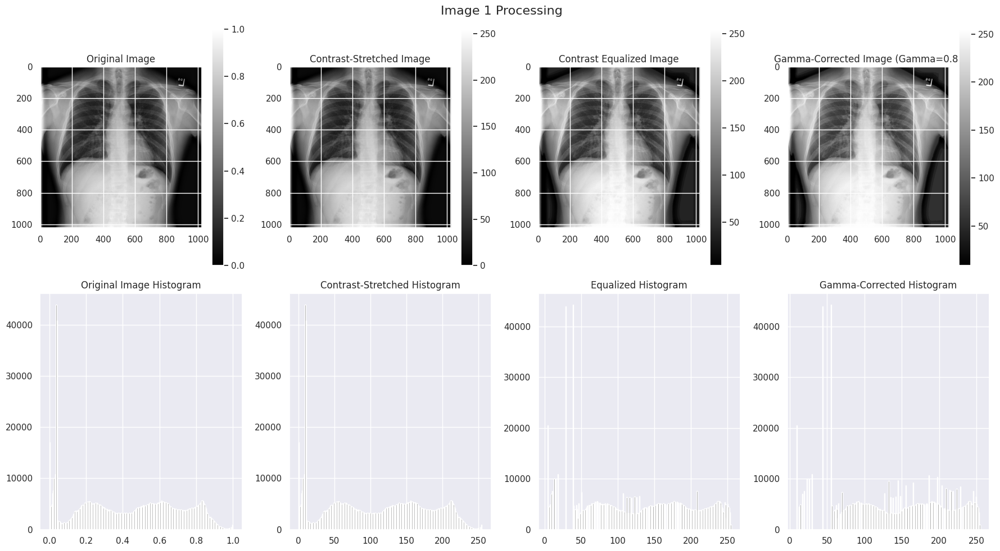

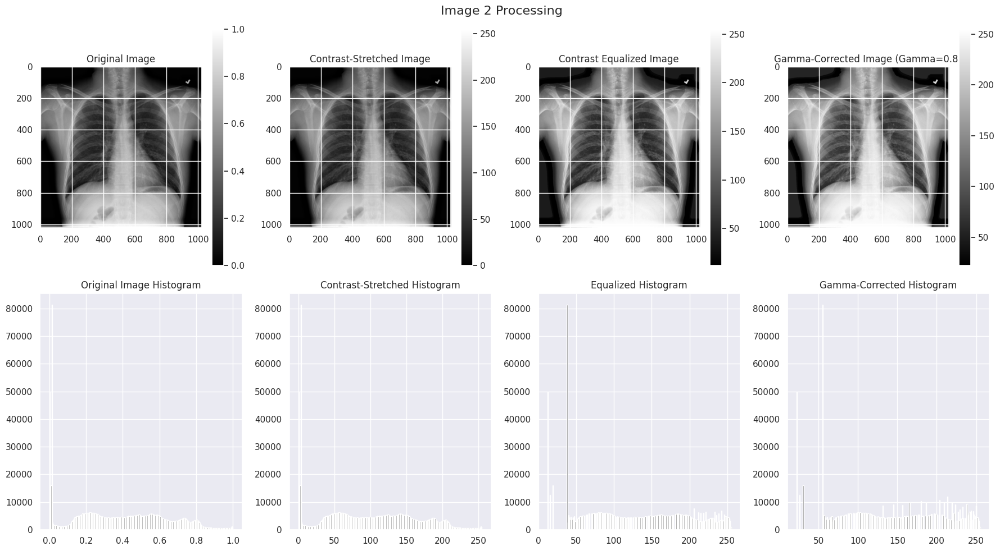

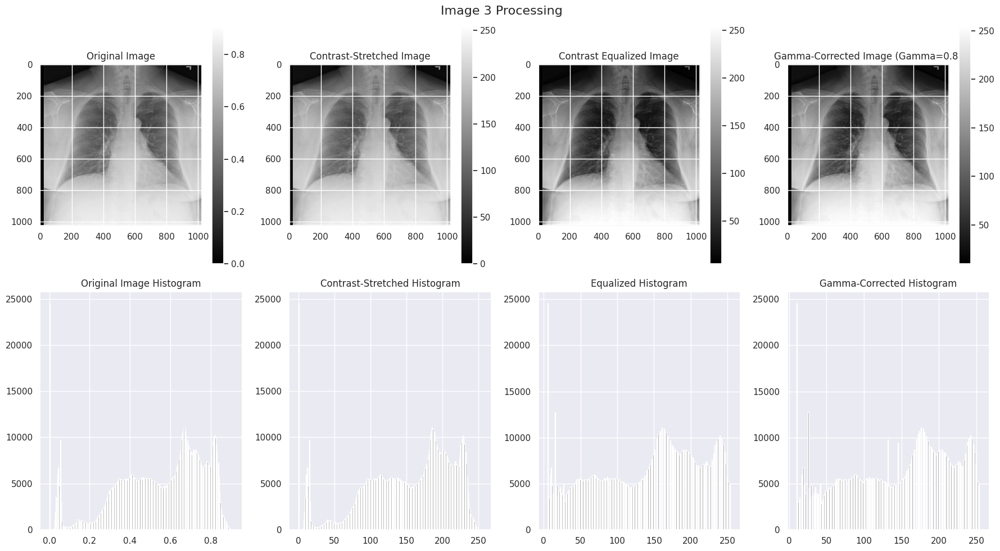

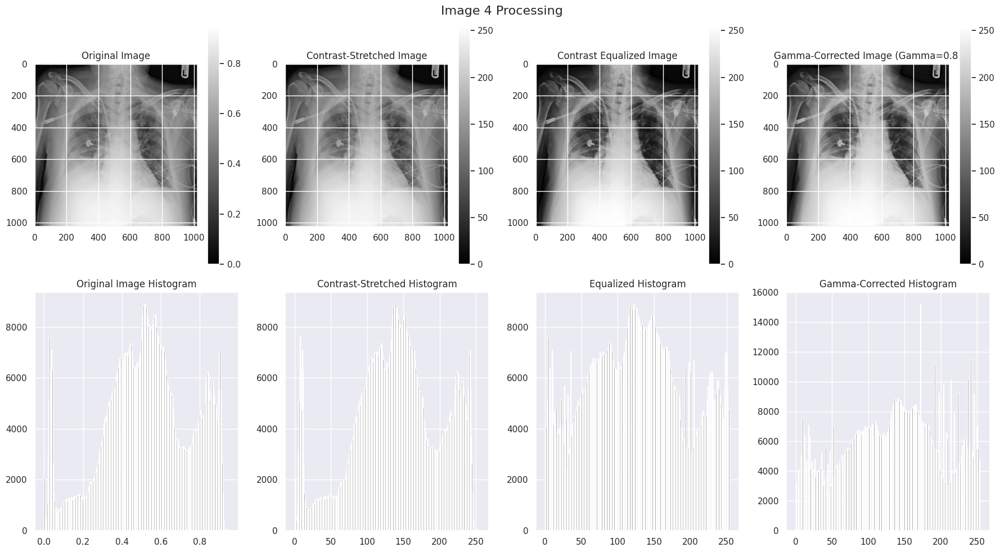

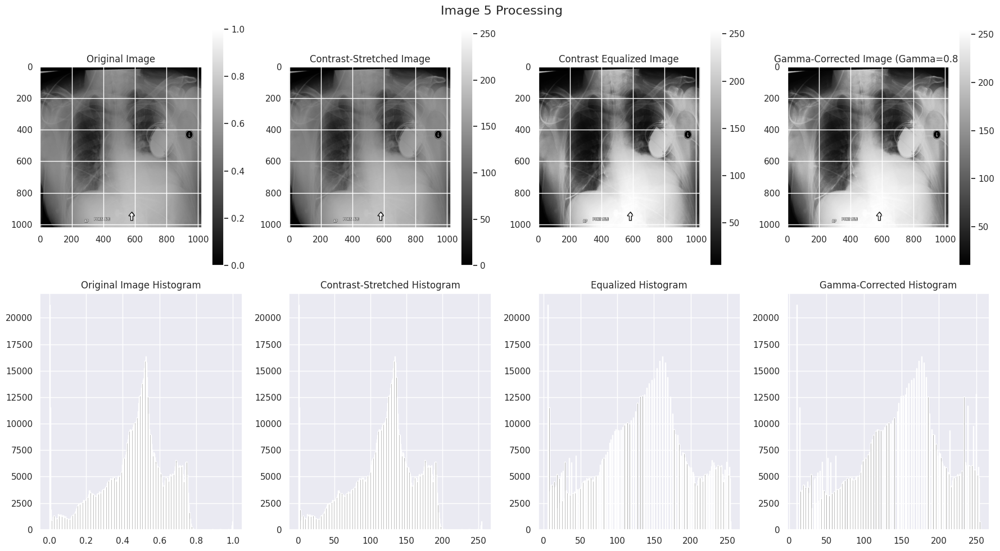

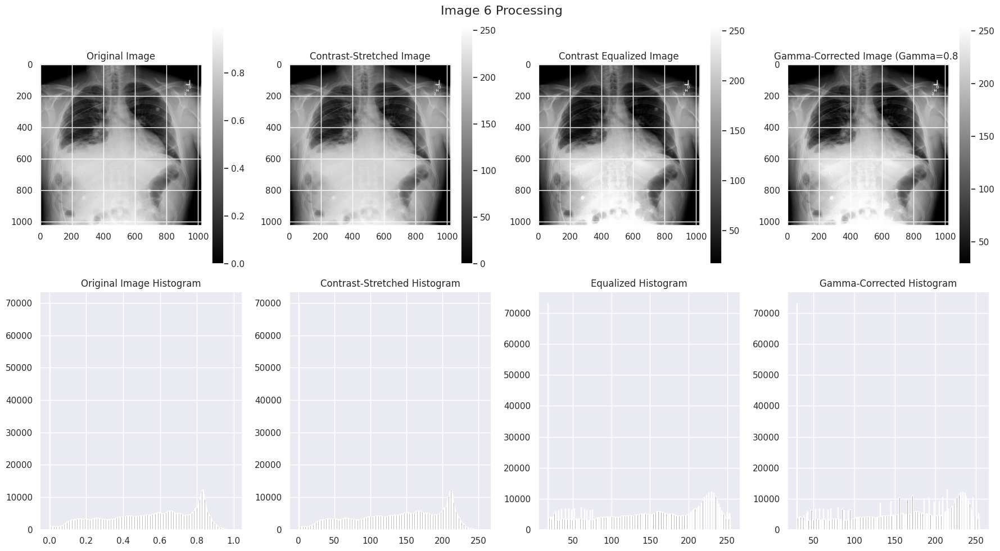

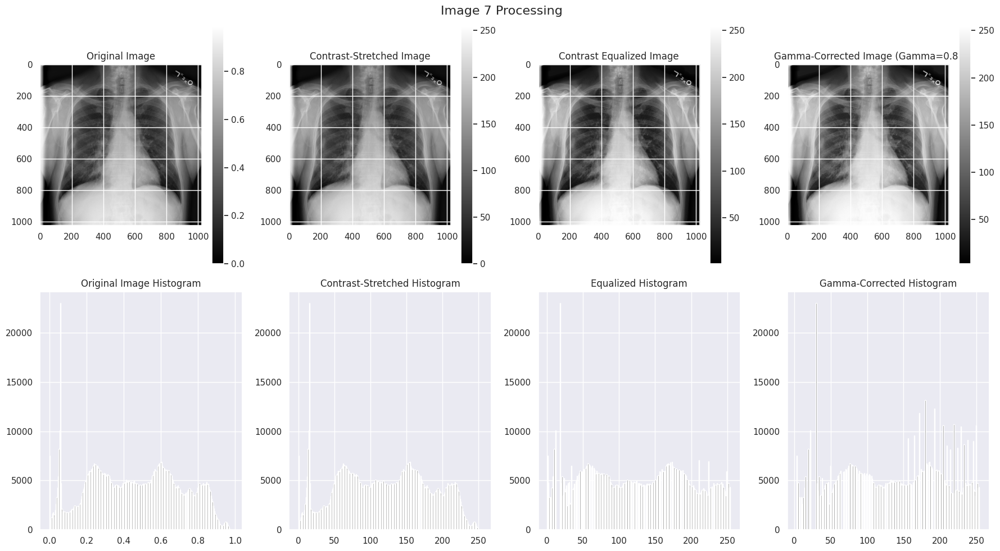

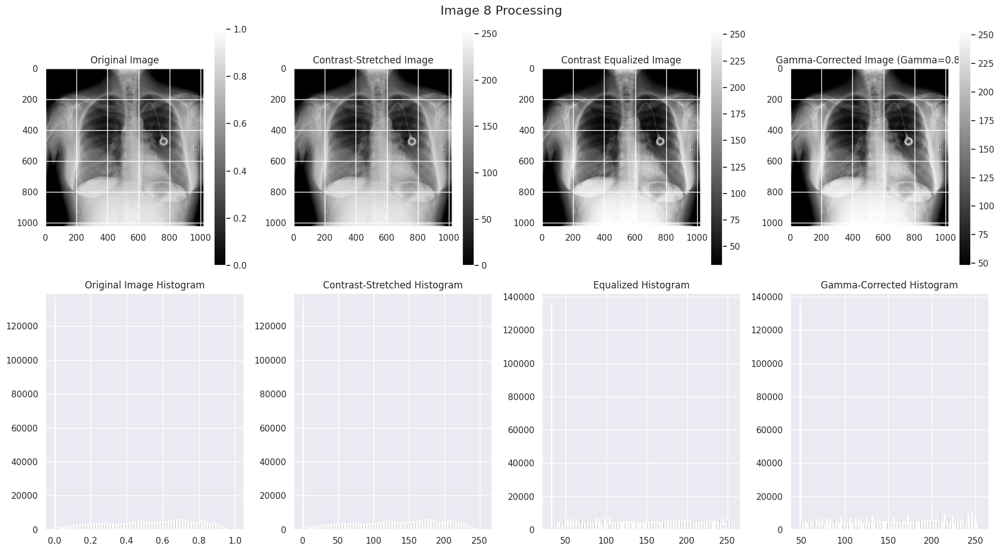

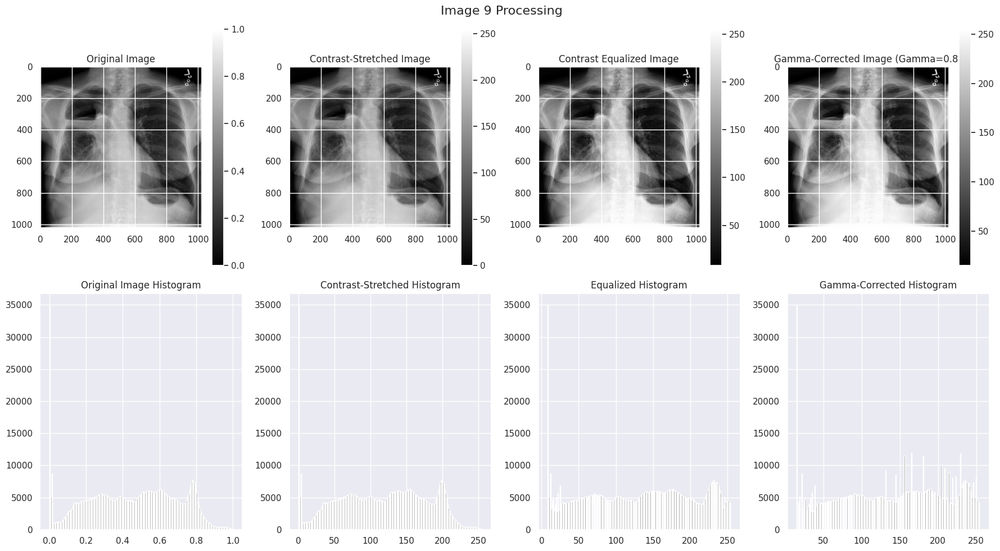

In [23]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import exposure
import os # Import the os module
# Örnek olarak random_images isimli 9 görüntü olduğunu varsayıyoruz
# random_images listesi içerisindeki her bir raw_image üzerinde işlem yapılacak
img_dir = 'nih/images_small/'


for i, image_file  in enumerate(random_images, start=1):
    # Her görüntü için min ve max değeri hesapla
    raw_image = plt.imread(os.path.join(img_dir, image_file))
    min_val, max_val = raw_image.min(), raw_image.max()

    # Adım 1: Kontrast genişletme (normalize edip [0, 255] aralığına çekiyoruz)
    contrast_stretched = (raw_image - min_val) / (max_val - min_val)  # Normalize [0, 1]
    contrast_stretched = (contrast_stretched * 255).astype(np.uint8)  # [0, 255] aralığına ölçeklendir

    # Adım 2: Kontrast eşitleme (histogram eşitleme)
    equalized_image = exposure.equalize_hist(contrast_stretched)  # [0, 1] aralığında değer döndürür
    equalized_image = (equalized_image * 255).astype(np.uint8)  # [0, 255] aralığına ölçeklendir

    # Adım 3: Gamma düzeltmesi
    gamma = 0.8  # Gamma değeri
    gamma_corrected = np.power(equalized_image / 255.0, gamma) * 255
    gamma_corrected = gamma_corrected.astype(np.uint8)

    # Görüntüleri ve histogramları çizdirme
    plt.figure(figsize=(18, 10))
    plt.suptitle(f"Image {i} Processing", fontsize=16)

    # Orijinal görüntü ve histogram
    plt.subplot(2, 4, 1)
    plt.imshow(raw_image, cmap='gray')
    plt.title('Original Image')
    plt.colorbar()
    plt.subplot(2, 4, 5)
    plt.hist(raw_image.ravel(), bins=256, color='gray')
    plt.title("Original Image Histogram")

    # Kontrast genişletilmiş görüntü ve histogram
    plt.subplot(2, 4, 2)
    plt.imshow(contrast_stretched, cmap='gray')
    plt.title('Contrast-Stretched Image')
    plt.colorbar()
    plt.subplot(2, 4, 6)
    plt.hist(contrast_stretched.ravel(), bins=256, color='gray')
    plt.title("Contrast-Stretched Histogram")

    # Histogram eşitlenmiş görüntü ve histogram
    plt.subplot(2, 4, 3)
    plt.imshow(equalized_image, cmap='gray')
    plt.title('Contrast Equalized Image')
    plt.colorbar()
    plt.subplot(2, 4, 7)
    plt.hist(equalized_image.ravel(), bins=256, color='gray')
    plt.title("Equalized Histogram")

    # Gamma düzeltmeli görüntü ve histogram
    plt.subplot(2, 4, 4)
    plt.imshow(gamma_corrected, cmap='gray')
    plt.title(f'Gamma-Corrected Image (Gamma={gamma})')
    plt.colorbar()
    plt.subplot(2, 4, 8)
    plt.hist(gamma_corrected.ravel(), bins=256, color='gray')
    plt.title("Gamma-Corrected Histogram")

    plt.tight_layout()
    plt.show()


# Gamma 1.2

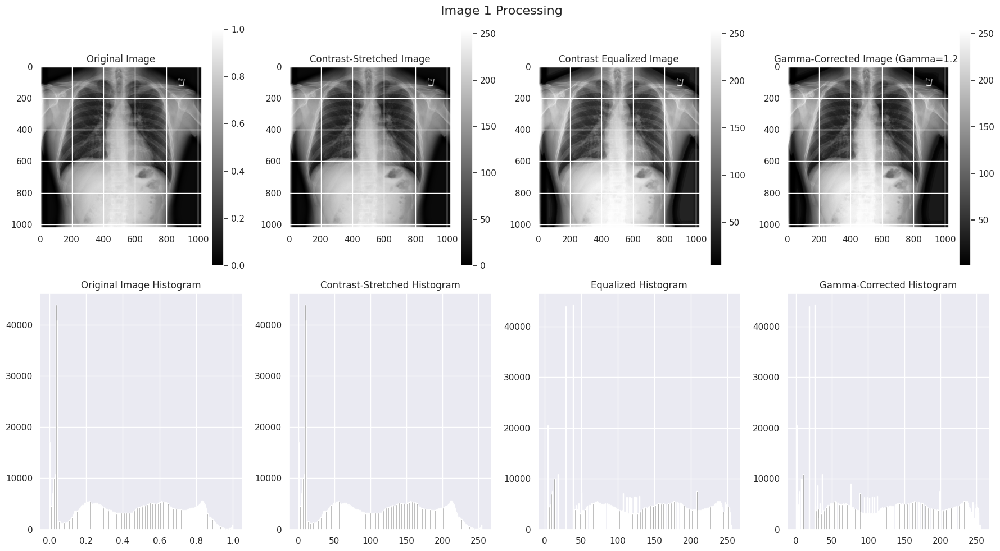

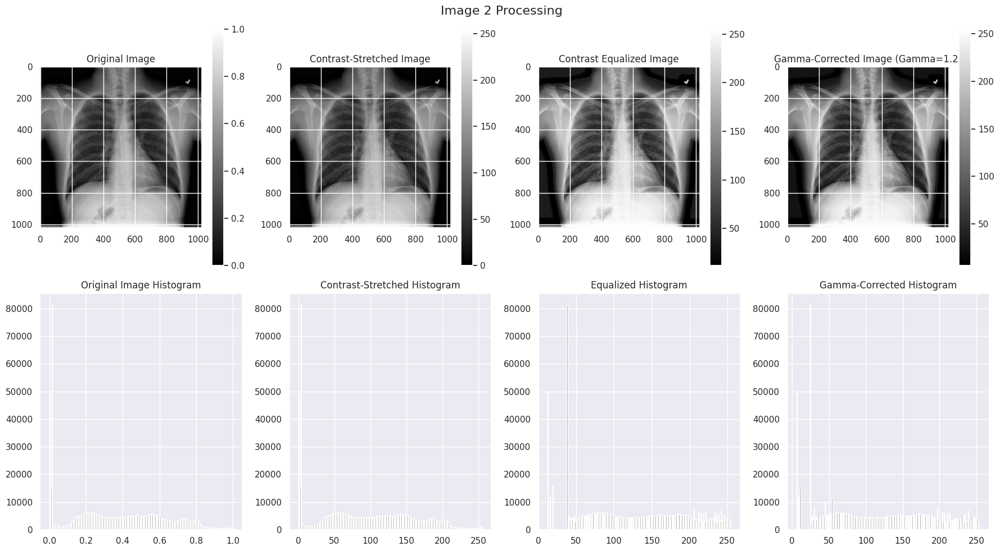

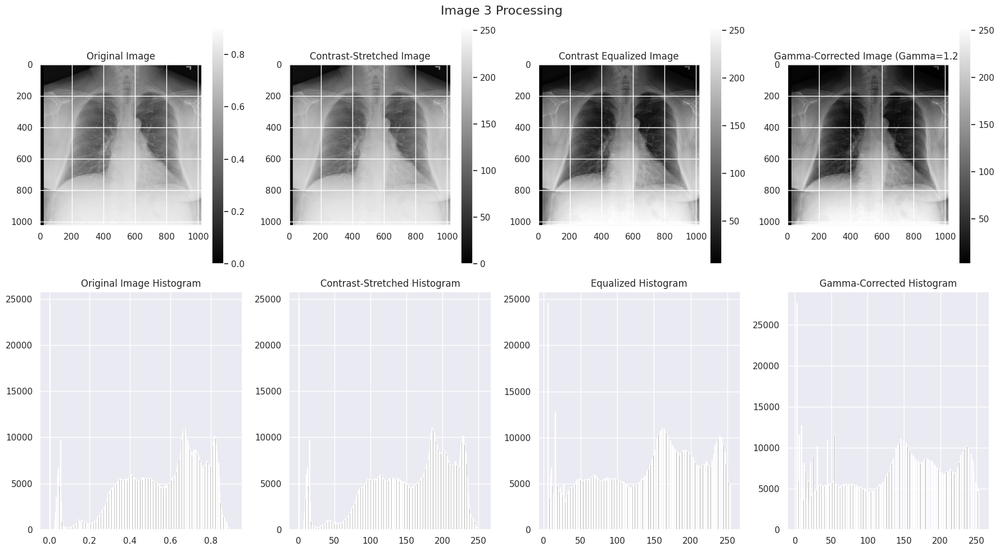

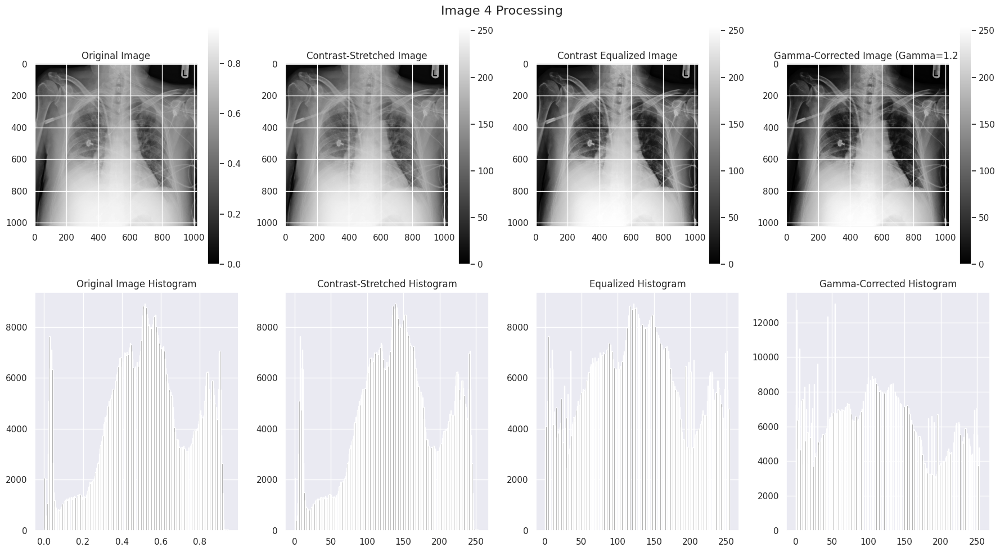

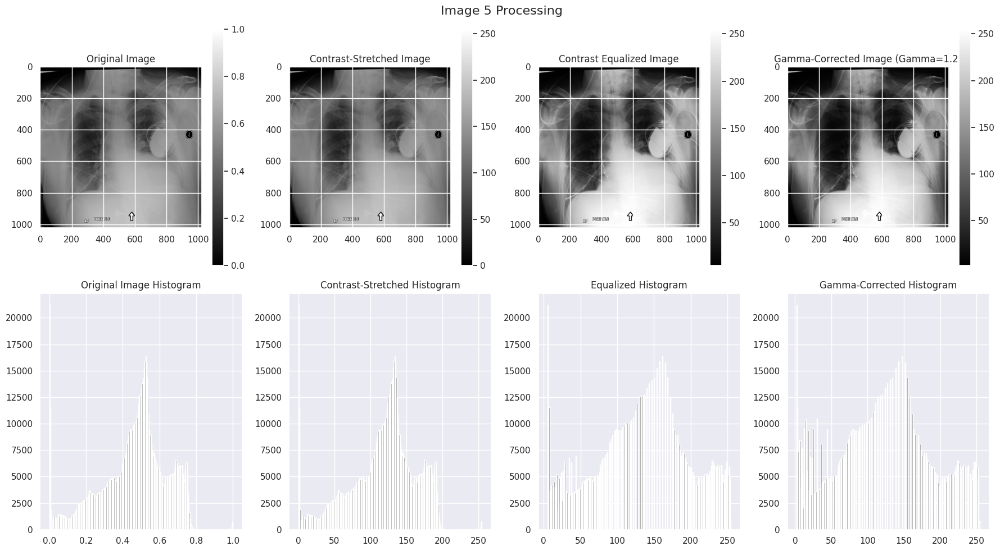

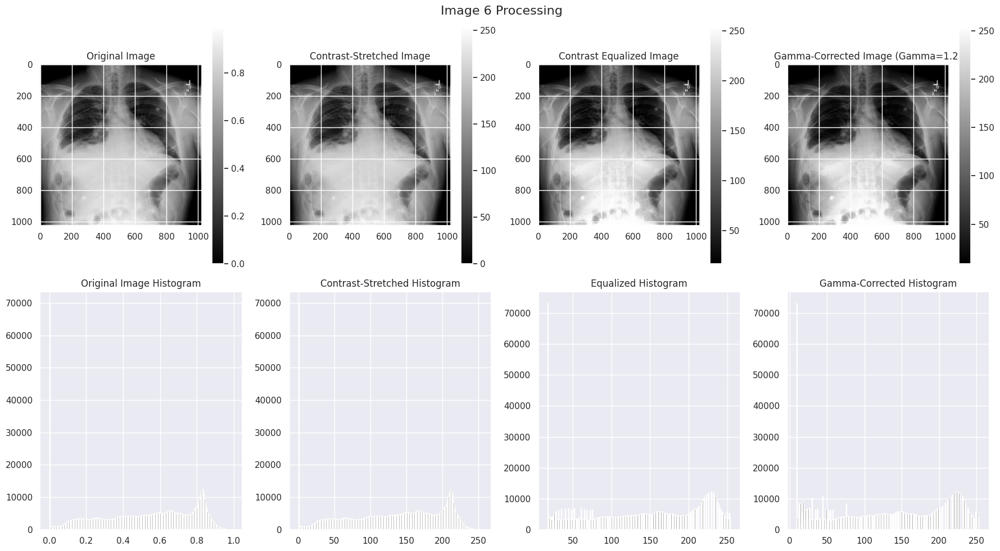

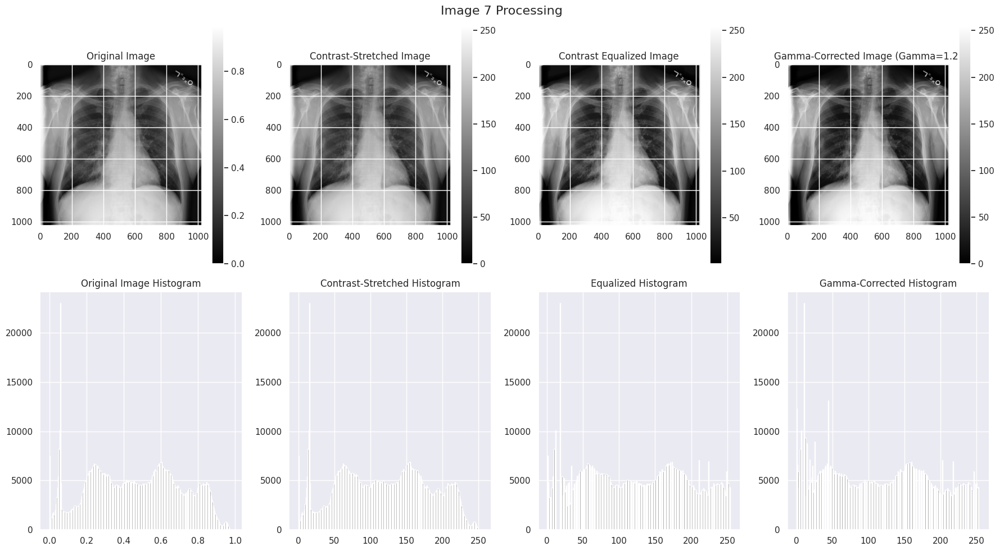

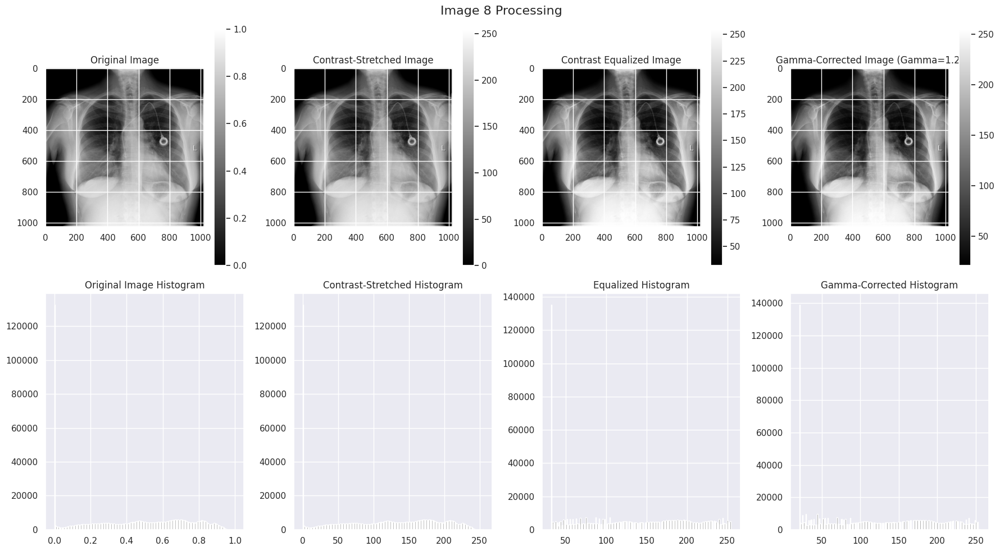

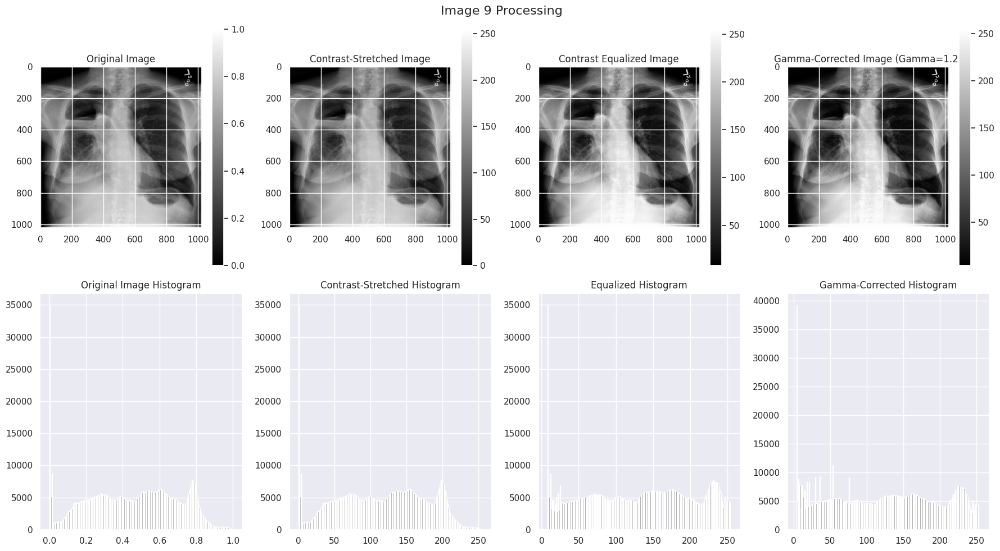

In [14]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import exposure
import os # Import the os module
# Örnek olarak random_images isimli 9 görüntü olduğunu varsayıyoruz
# random_images listesi içerisindeki her bir raw_image üzerinde işlem yapılacak
img_dir = 'nih/images_small/'


for i, image_file  in enumerate(random_images, start=1):
    # Her görüntü için min ve max değeri hesapla
    raw_image = plt.imread(os.path.join(img_dir, image_file))
    min_val, max_val = raw_image.min(), raw_image.max()

    # Adım 1: Kontrast genişletme (normalize edip [0, 255] aralığına çekiyoruz)
    contrast_stretched = (raw_image - min_val) / (max_val - min_val)  # Normalize [0, 1]
    contrast_stretched = (contrast_stretched * 255).astype(np.uint8)  # [0, 255] aralığına ölçeklendir

    # Adım 2: Kontrast eşitleme (histogram eşitleme)
    equalized_image = exposure.equalize_hist(contrast_stretched)  # [0, 1] aralığında değer döndürür
    equalized_image = (equalized_image * 255).astype(np.uint8)  # [0, 255] aralığına ölçeklendir

    # Adım 3: Gamma düzeltmesi
    gamma = 1.2  # Gamma değeri
    gamma_corrected = np.power(equalized_image / 255.0, gamma) * 255
    gamma_corrected = gamma_corrected.astype(np.uint8)

    # Görüntüleri ve histogramları çizdirme
    plt.figure(figsize=(18, 10))
    plt.suptitle(f"Image {i} Processing", fontsize=16)

    # Orijinal görüntü ve histogram
    plt.subplot(2, 4, 1)
    plt.imshow(raw_image, cmap='gray')
    plt.title('Original Image')
    plt.colorbar()
    plt.subplot(2, 4, 5)
    plt.hist(raw_image.ravel(), bins=256, color='gray')
    plt.title("Original Image Histogram")

    # Kontrast genişletilmiş görüntü ve histogram
    plt.subplot(2, 4, 2)
    plt.imshow(contrast_stretched, cmap='gray')
    plt.title('Contrast-Stretched Image')
    plt.colorbar()
    plt.subplot(2, 4, 6)
    plt.hist(contrast_stretched.ravel(), bins=256, color='gray')
    plt.title("Contrast-Stretched Histogram")

    # Histogram eşitlenmiş görüntü ve histogram
    plt.subplot(2, 4, 3)
    plt.imshow(equalized_image, cmap='gray')
    plt.title('Contrast Equalized Image')
    plt.colorbar()
    plt.subplot(2, 4, 7)
    plt.hist(equalized_image.ravel(), bins=256, color='gray')
    plt.title("Equalized Histogram")

    # Gamma düzeltmeli görüntü ve histogram
    plt.subplot(2, 4, 4)
    plt.imshow(gamma_corrected, cmap='gray')
    plt.title(f'Gamma-Corrected Image (Gamma={gamma})')
    plt.colorbar()
    plt.subplot(2, 4, 8)
    plt.hist(gamma_corrected.ravel(), bins=256, color='gray')
    plt.title("Gamma-Corrected Histogram")

    plt.tight_layout()
    plt.show()


Görüntü 1:


Orijinal histogram sağa çarpık bir dağılım gösteriyor (yüksek yoğunluk değerlerinde pikler var)
Gamma düzeltmesi sonrası histogram daha dengeli dağılıma sahip, orta tonlarda daha fazla detay ortaya çıkmış


Görüntü 2:


Benzer şekilde orijinal histogram sağa çarpık
Gamma düzeltmesi sonrası dağılım daha uniform hale gelmiş, özellikle orta tonlarda iyileşme görülüyor


Görüntü 3:


Orijinal histogram yine sağa çarpık ancak biraz daha dengeli
Gamma düzeltmesi ile özellikle karanlık bölgelerde detaylar artmış


Görüntü 4:


Orijinal histogram daha düşük kontrastlı ve geniş bir dağılıma sahip
Gamma düzeltmesi sonrası histogram daha keskin pikler gösteriyor, bu da kontrastın arttığını gösteriyor


Görüntü 5:


Orijinal histogram orta tonlarda yoğunlaşmış
Gamma düzeltmesi ile histogram daha geniş bir dinamik aralığa yayılmış

Görüntü 6:

Original histogram'da pikler daha keskin ve yoğunlaşmış
Gamma düzeltmesi sonrası histogram daha yumuşak bir dağılım gösteriyor
Akciğer detayları daha net görünür hale geliyor

Görüntü 7:

Original histogram'da orta tonlarda yoğunlaşma var
Gamma düzeltmesi sonrası dağılım daha geniş bir aralığa yayılıyor
Özellikle akciğer dokusundaki ince detaylar daha belirgin

Görüntü 8:

Original histogram'da düşük kontrastlı bir dağılım görülüyor
Gamma düzeltmesi sonrası histogram daha geniş bir dinamik aralığa sahip
Anatomik yapılar daha iyi ayırt edilebilir hale geliyor

Görüntü 9:

Original histogram'da Gaussian benzeri bir dağılım var
Gamma düzeltmesi sonrası yüksek yoğunluklu bölgelerde daha fazla detay ortaya çıkıyor
Kemik yapılar ve yumuşak doku kontrastı artıyor

Genel Değerlendirme:

Gamma düzeltmesi genellikle:

Görüntülerdeki kontrastı artırmış
Karanlık bölgelerdeki detayları ortaya çıkarmış
Histogram dağılımını daha dengeli hale getirmiş


Bu değişiklikler özellikle X-ray görüntülerinde önemli çünkü:

Doku detaylarının daha iyi görünmesini sağlıyor


Original Image Histogram'lar genellikle 0.0-1.0 aralığında normalize edilmiş değerler gösterirken, Gamma-Corrected Histogram'lar 0-250 aralığında piksel yoğunluk değerleri gösteriyor.
Gamma düzeltmesi (γ=1.2) uygulandığında:

Karanlık bölgelerde (düşük yoğunluklu) daha fazla detay ortaya çıkıyor
Histogram dağılımı daha dengeli hale geliyor
Kontrast artıyor ve görüntü detayları daha belirgin oluyor



# Gamma 2.0

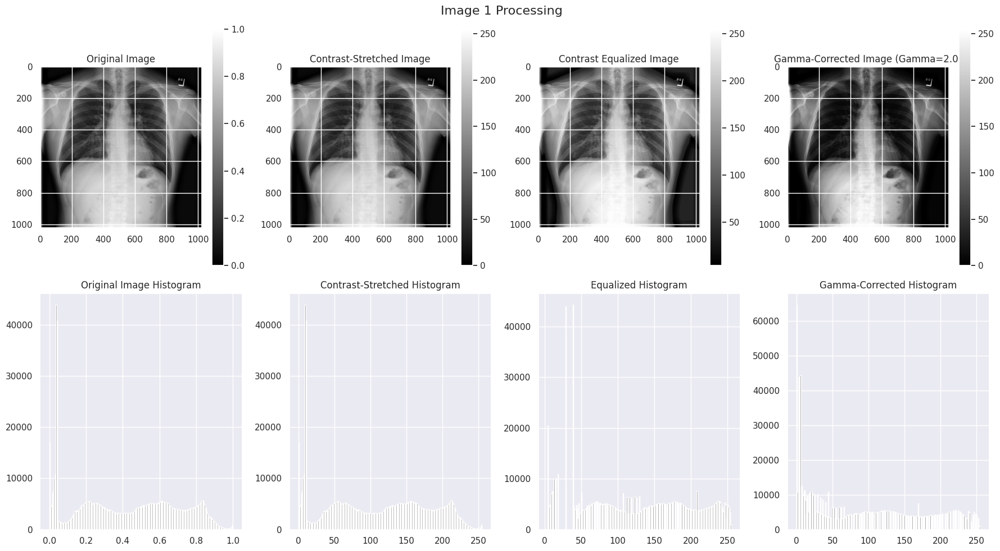

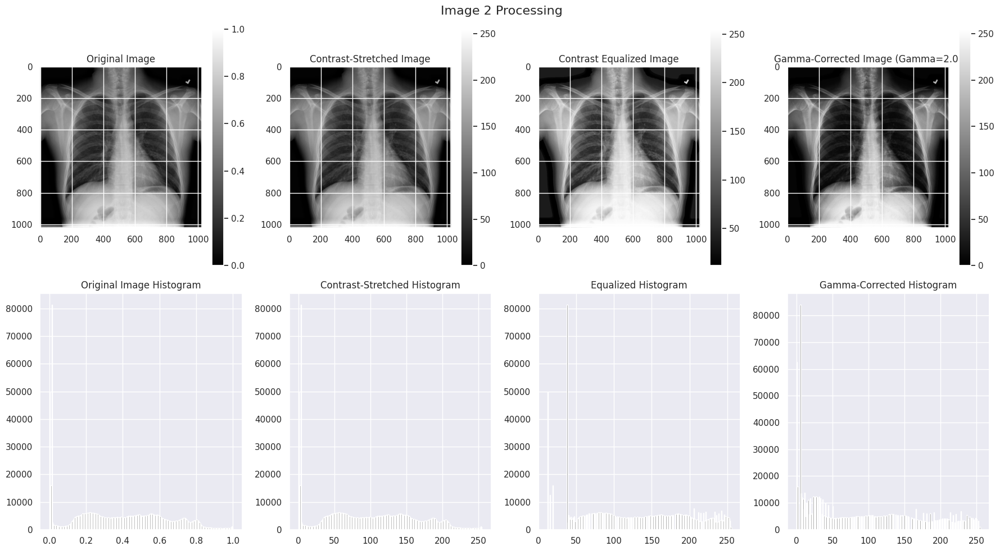

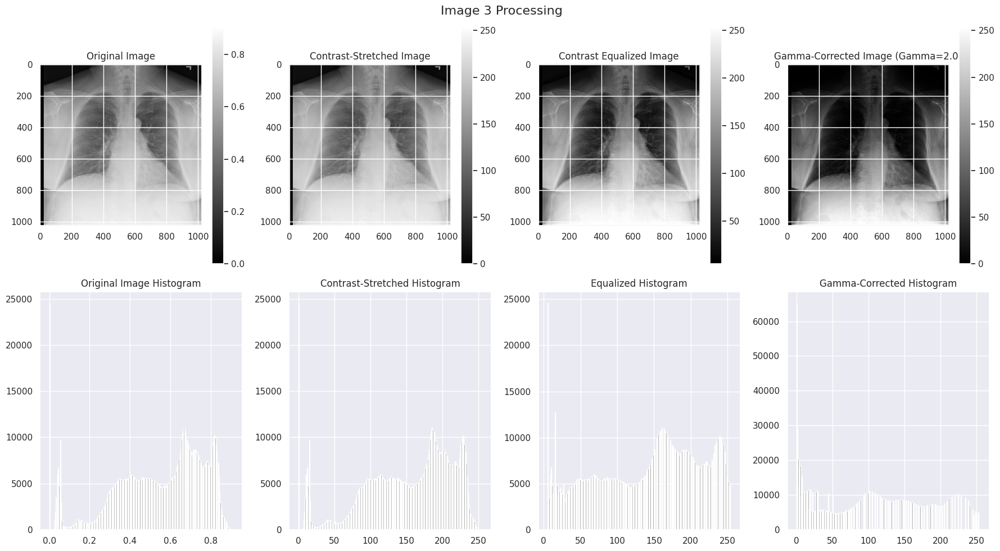

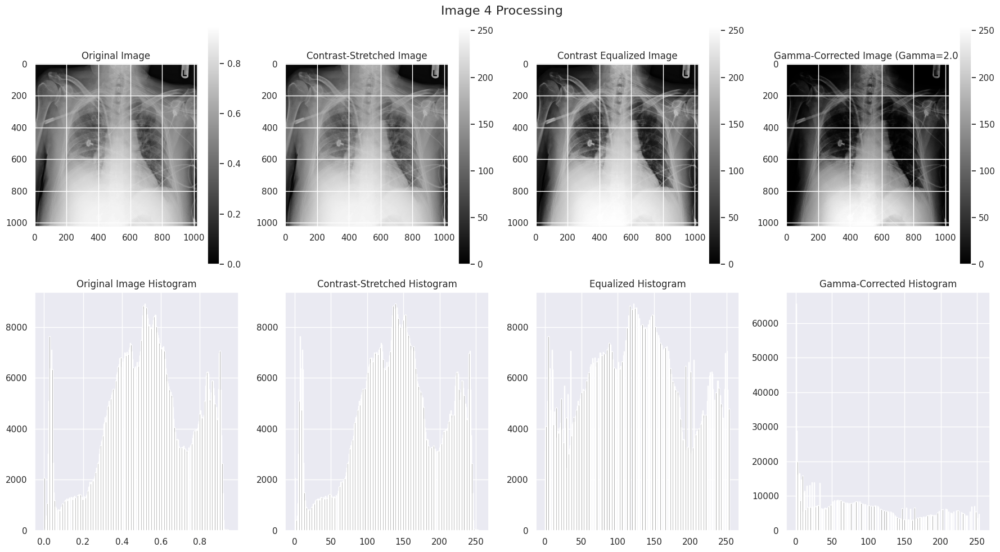

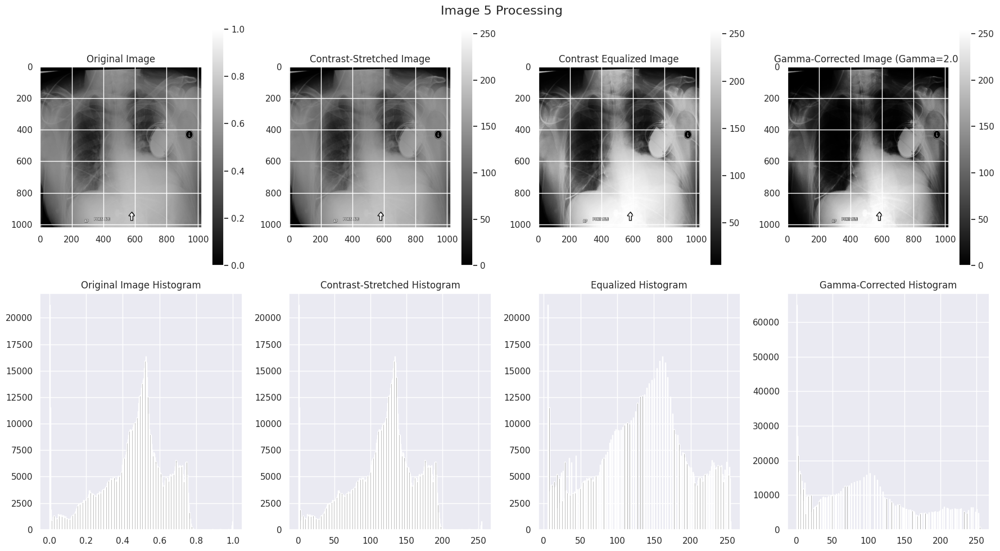

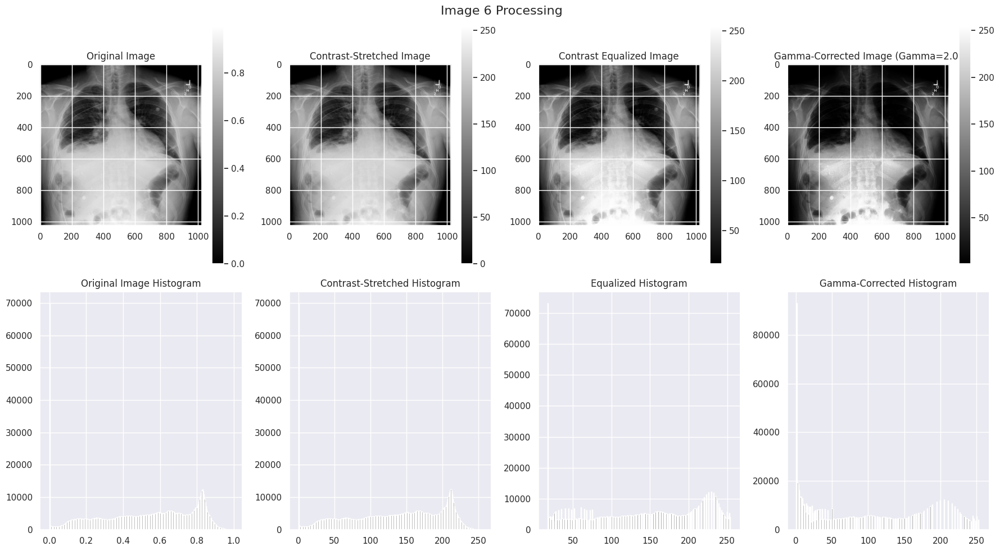

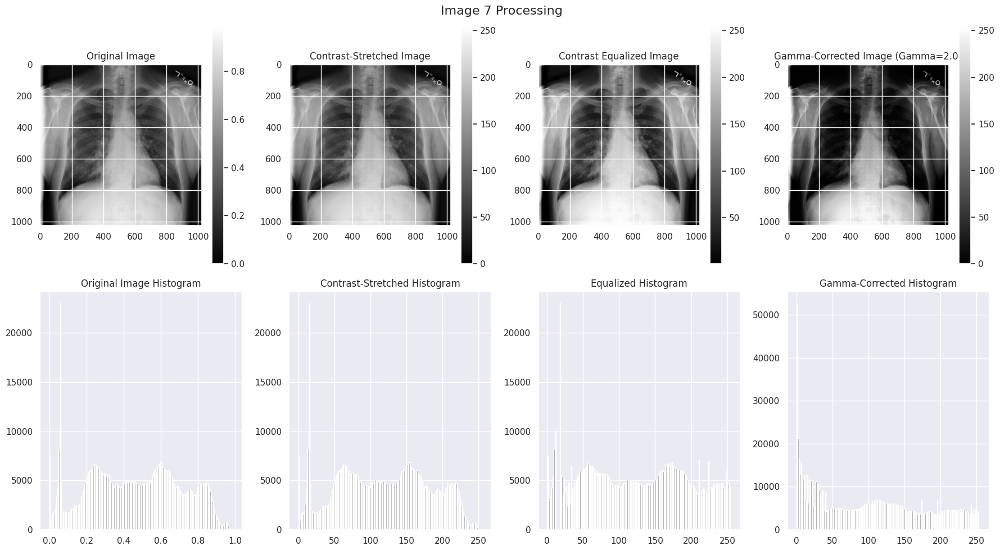

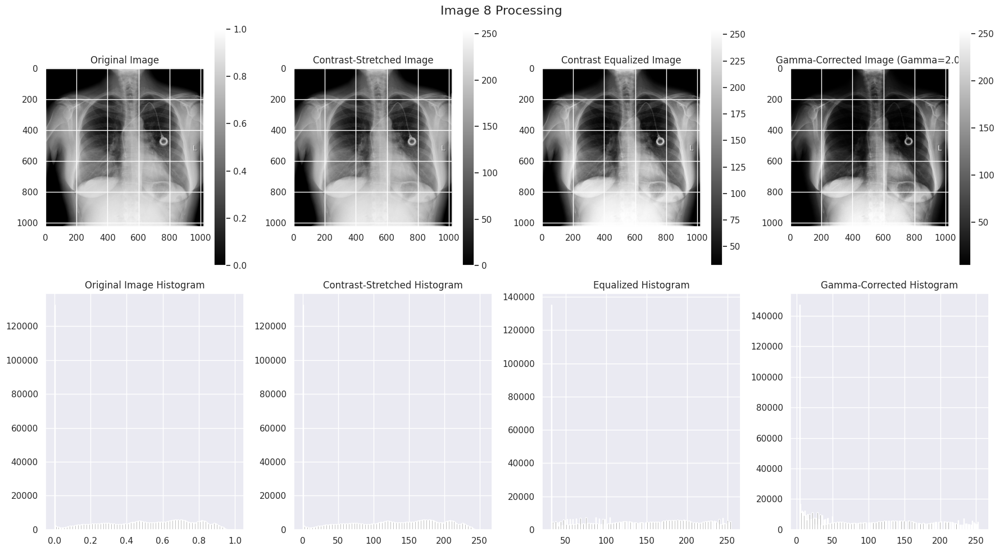

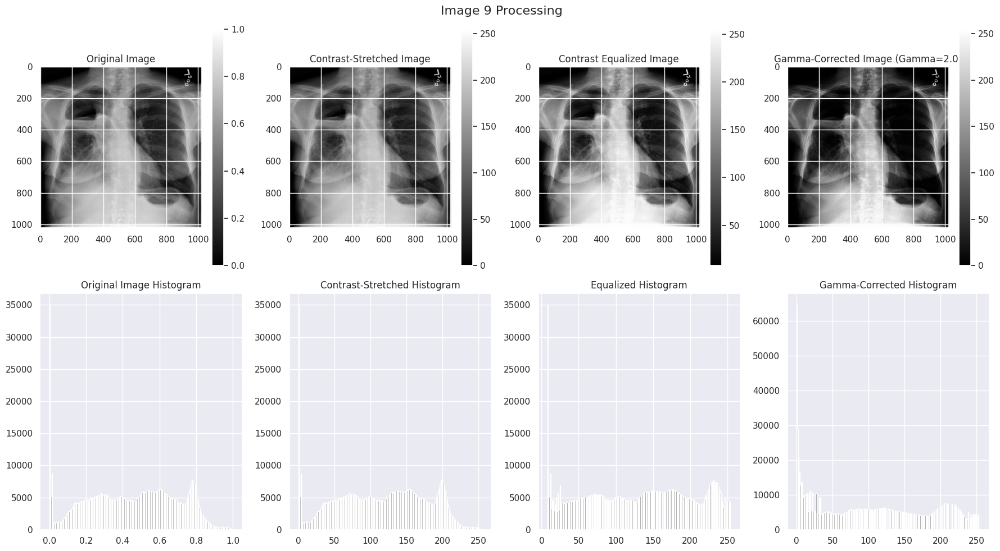

In [15]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import exposure
import os # Import the os module
# Örnek olarak random_images isimli 9 görüntü olduğunu varsayıyoruz
# random_images listesi içerisindeki her bir raw_image üzerinde işlem yapılacak
img_dir = 'nih/images_small/'


for i, image_file  in enumerate(random_images, start=1):
    # Her görüntü için min ve max değeri hesapla
    raw_image = plt.imread(os.path.join(img_dir, image_file))
    min_val, max_val = raw_image.min(), raw_image.max()

    # Adım 1: Kontrast genişletme (normalize edip [0, 255] aralığına çekiyoruz)
    contrast_stretched = (raw_image - min_val) / (max_val - min_val)  # Normalize [0, 1]
    contrast_stretched = (contrast_stretched * 255).astype(np.uint8)  # [0, 255] aralığına ölçeklendir

    # Adım 2: Kontrast eşitleme (histogram eşitleme)
    equalized_image = exposure.equalize_hist(contrast_stretched)  # [0, 1] aralığında değer döndürür
    equalized_image = (equalized_image * 255).astype(np.uint8)  # [0, 255] aralığına ölçeklendir

    # Adım 3: Gamma düzeltmesi
    gamma = 2.0  # Gamma değeri
    gamma_corrected = np.power(equalized_image / 255.0, gamma) * 255
    gamma_corrected = gamma_corrected.astype(np.uint8)

    # Görüntüleri ve histogramları çizdirme
    plt.figure(figsize=(18, 10))
    plt.suptitle(f"Image {i} Processing", fontsize=16)

    # Orijinal görüntü ve histogram
    plt.subplot(2, 4, 1)
    plt.imshow(raw_image, cmap='gray')
    plt.title('Original Image')
    plt.colorbar()
    plt.subplot(2, 4, 5)
    plt.hist(raw_image.ravel(), bins=256, color='gray')
    plt.title("Original Image Histogram")

    # Kontrast genişletilmiş görüntü ve histogram
    plt.subplot(2, 4, 2)
    plt.imshow(contrast_stretched, cmap='gray')
    plt.title('Contrast-Stretched Image')
    plt.colorbar()
    plt.subplot(2, 4, 6)
    plt.hist(contrast_stretched.ravel(), bins=256, color='gray')
    plt.title("Contrast-Stretched Histogram")

    # Histogram eşitlenmiş görüntü ve histogram
    plt.subplot(2, 4, 3)
    plt.imshow(equalized_image, cmap='gray')
    plt.title('Contrast Equalized Image')
    plt.colorbar()
    plt.subplot(2, 4, 7)
    plt.hist(equalized_image.ravel(), bins=256, color='gray')
    plt.title("Equalized Histogram")

    # Gamma düzeltmeli görüntü ve histogram
    plt.subplot(2, 4, 4)
    plt.imshow(gamma_corrected, cmap='gray')
    plt.title(f'Gamma-Corrected Image (Gamma={gamma})')
    plt.colorbar()
    plt.subplot(2, 4, 8)
    plt.hist(gamma_corrected.ravel(), bins=256, color='gray')
    plt.title("Gamma-Corrected Histogram")

    plt.tight_layout()
    plt.show()


# Gamma 3.0

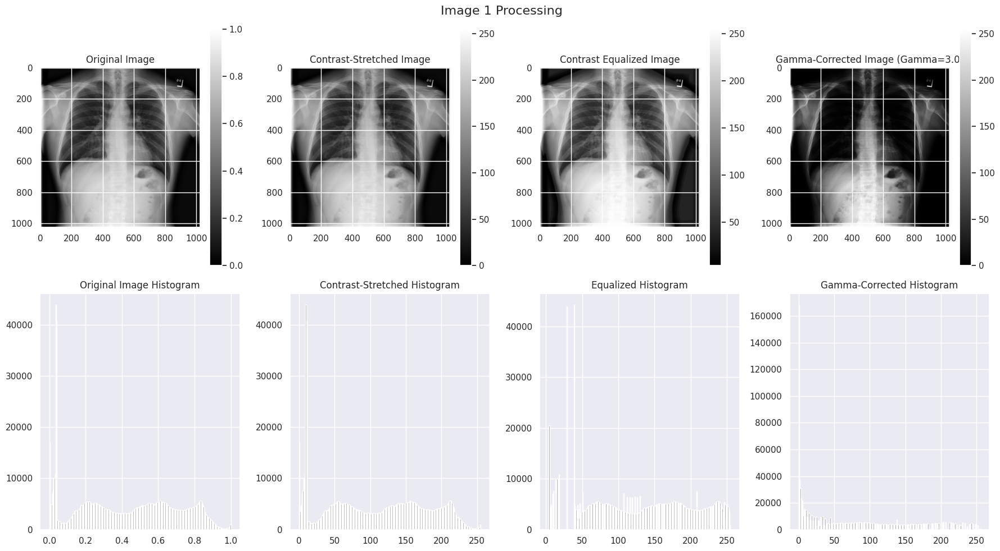

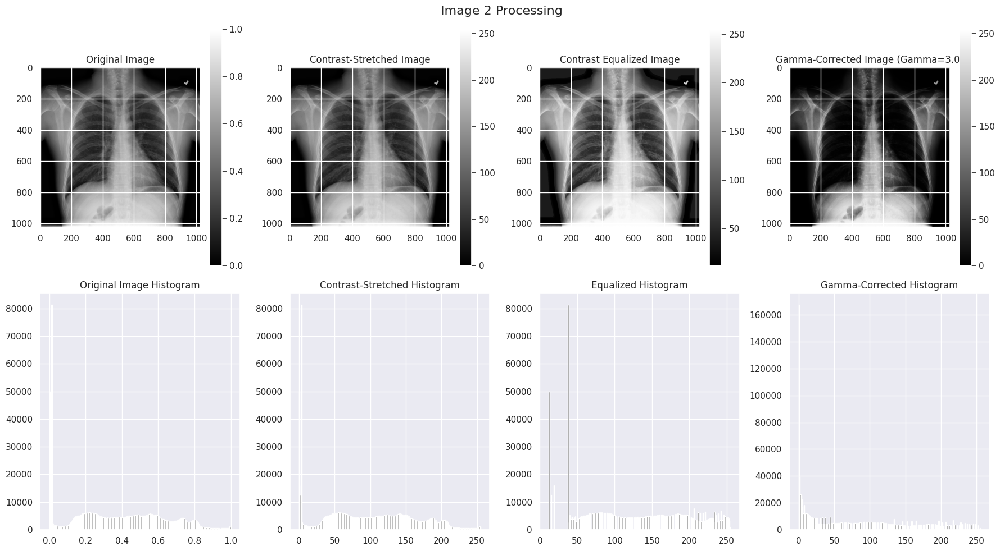

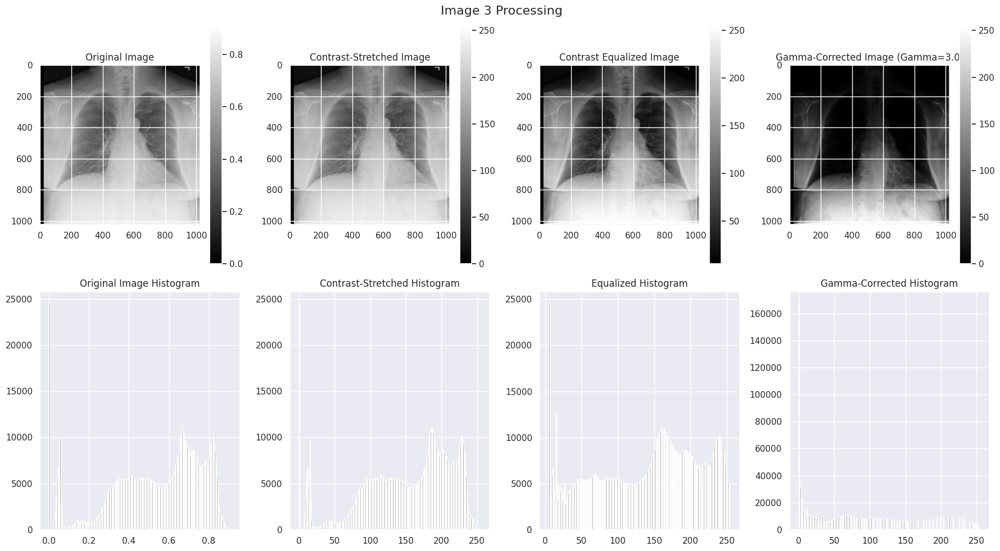

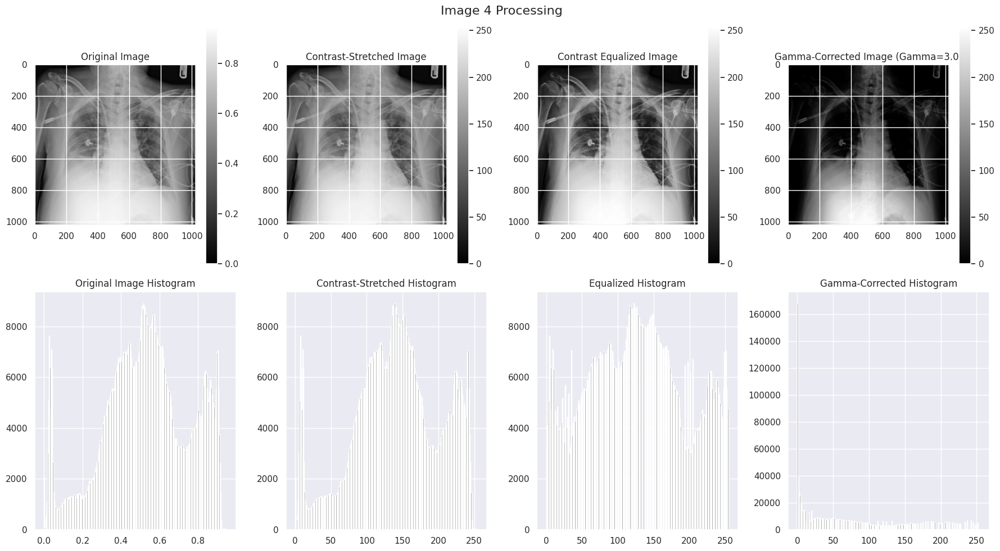

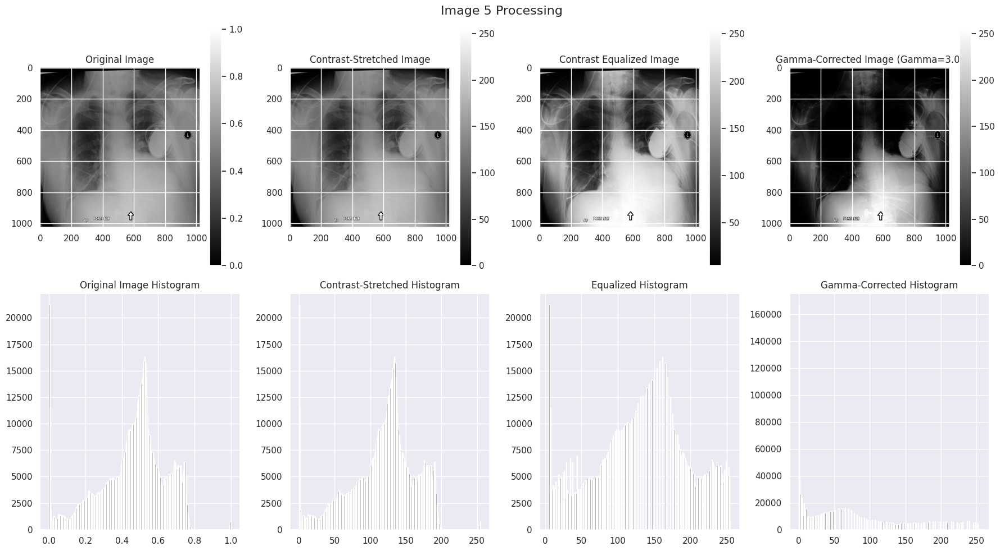

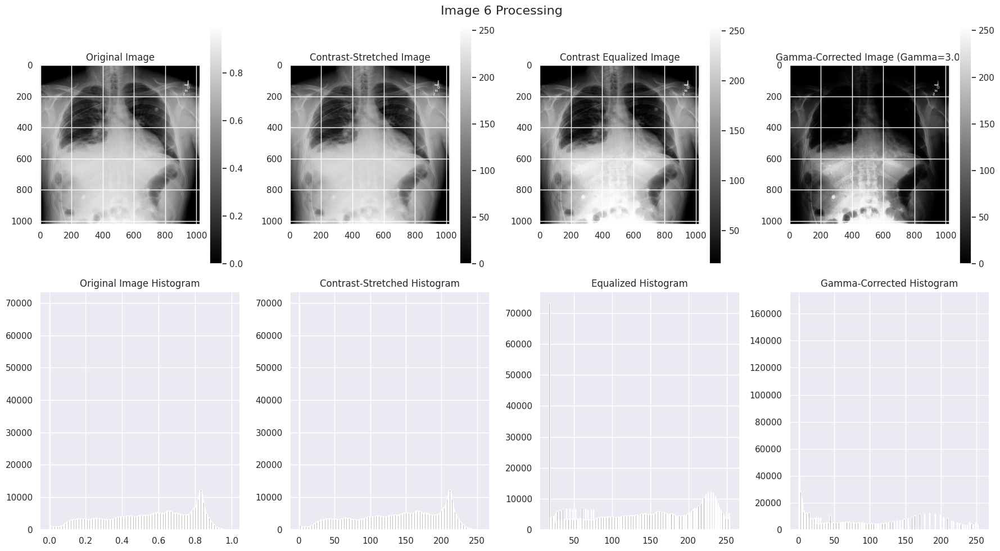

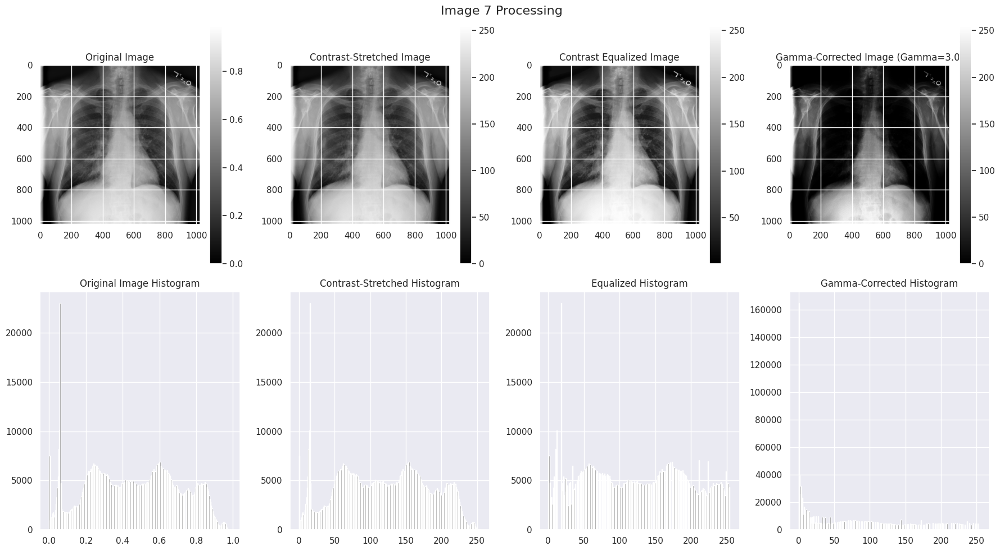

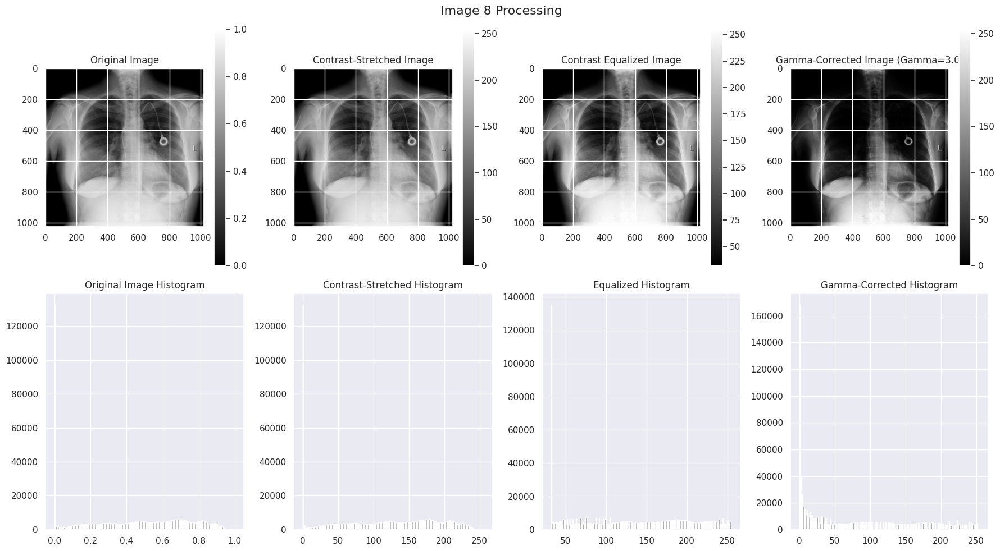

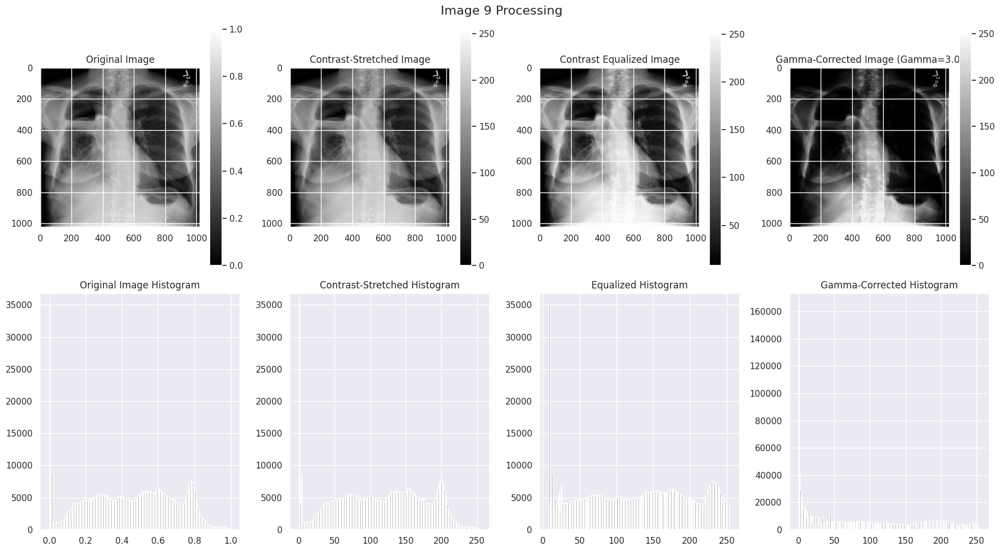

In [16]:
import numpy as np
import matplotlib.pyplot as plt
from skimage import exposure
import os # Import the os module
# Örnek olarak random_images isimli 9 görüntü olduğunu varsayıyoruz
# random_images listesi içerisindeki her bir raw_image üzerinde işlem yapılacak
img_dir = 'nih/images_small/'


for i, image_file  in enumerate(random_images, start=1):
    # Her görüntü için min ve max değeri hesapla
    raw_image = plt.imread(os.path.join(img_dir, image_file))
    min_val, max_val = raw_image.min(), raw_image.max()

    # Adım 1: Kontrast genişletme (normalize edip [0, 255] aralığına çekiyoruz)
    contrast_stretched = (raw_image - min_val) / (max_val - min_val)  # Normalize [0, 1]
    contrast_stretched = (contrast_stretched * 255).astype(np.uint8)  # [0, 255] aralığına ölçeklendir

    # Adım 2: Kontrast eşitleme (histogram eşitleme)
    equalized_image = exposure.equalize_hist(contrast_stretched)  # [0, 1] aralığında değer döndürür
    equalized_image = (equalized_image * 255).astype(np.uint8)  # [0, 255] aralığına ölçeklendir

    # Adım 3: Gamma düzeltmesi
    gamma = 3.0  # Gamma değeri
    gamma_corrected = np.power(equalized_image / 255.0, gamma) * 255
    gamma_corrected = gamma_corrected.astype(np.uint8)

    # Görüntüleri ve histogramları çizdirme
    plt.figure(figsize=(18, 10))
    plt.suptitle(f"Image {i} Processing", fontsize=16)

    # Orijinal görüntü ve histogram
    plt.subplot(2, 4, 1)
    plt.imshow(raw_image, cmap='gray')
    plt.title('Original Image')
    plt.colorbar()
    plt.subplot(2, 4, 5)
    plt.hist(raw_image.ravel(), bins=256, color='gray')
    plt.title("Original Image Histogram")

    # Kontrast genişletilmiş görüntü ve histogram
    plt.subplot(2, 4, 2)
    plt.imshow(contrast_stretched, cmap='gray')
    plt.title('Contrast-Stretched Image')
    plt.colorbar()
    plt.subplot(2, 4, 6)
    plt.hist(contrast_stretched.ravel(), bins=256, color='gray')
    plt.title("Contrast-Stretched Histogram")

    # Histogram eşitlenmiş görüntü ve histogram
    plt.subplot(2, 4, 3)
    plt.imshow(equalized_image, cmap='gray')
    plt.title('Contrast Equalized Image')
    plt.colorbar()
    plt.subplot(2, 4, 7)
    plt.hist(equalized_image.ravel(), bins=256, color='gray')
    plt.title("Equalized Histogram")

    # Gamma düzeltmeli görüntü ve histogram
    plt.subplot(2, 4, 4)
    plt.imshow(gamma_corrected, cmap='gray')
    plt.title(f'Gamma-Corrected Image (Gamma={gamma})')
    plt.colorbar()
    plt.subplot(2, 4, 8)
    plt.hist(gamma_corrected.ravel(), bins=256, color='gray')
    plt.title("Gamma-Corrected Histogram")

    plt.tight_layout()
    plt.show()


Gamma sayısı arttıkça parlak bölgelerin daha koyulaştığı gözlemlendi. Histogram grafiklerinde de bu etki görülüyor. Daha geniş bir dağılım söz konusu.

#gamma corrected

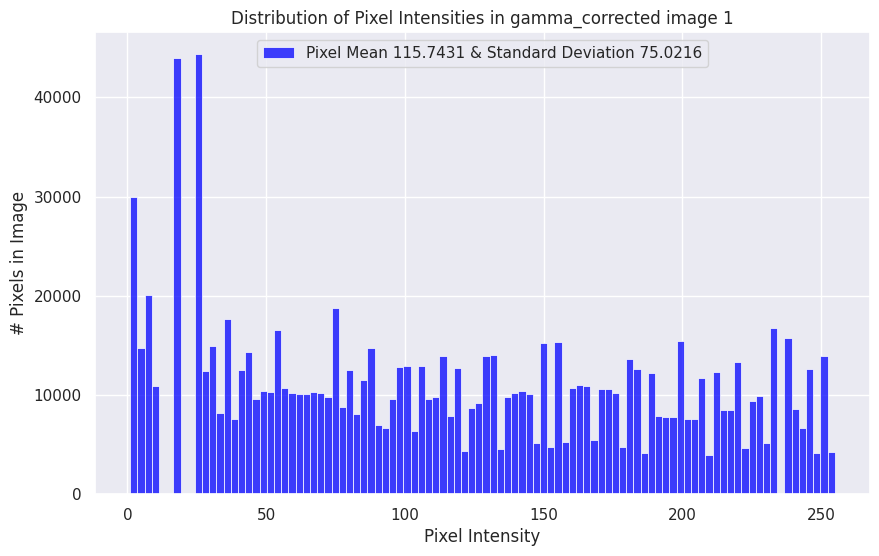

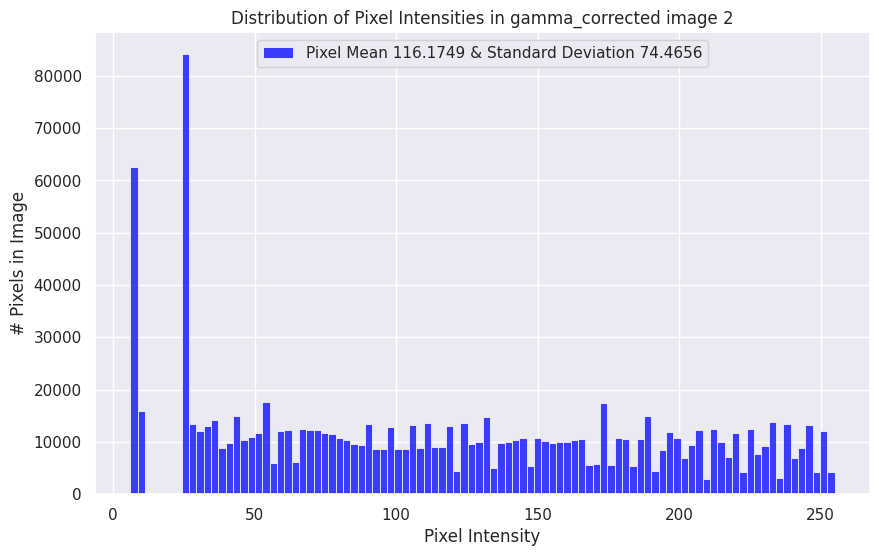

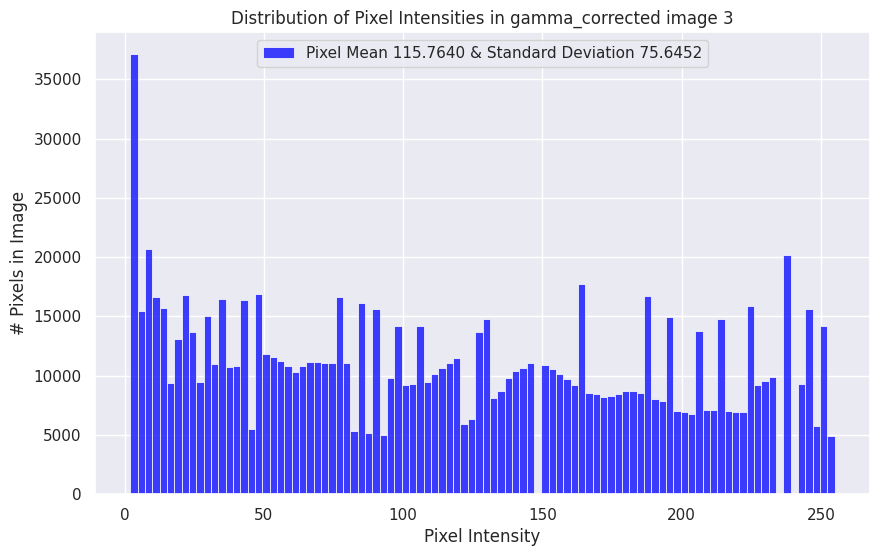

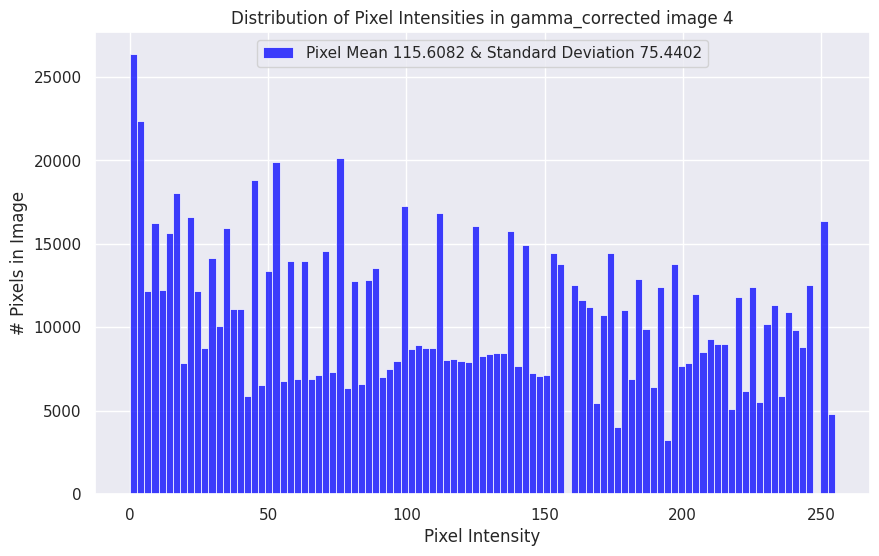

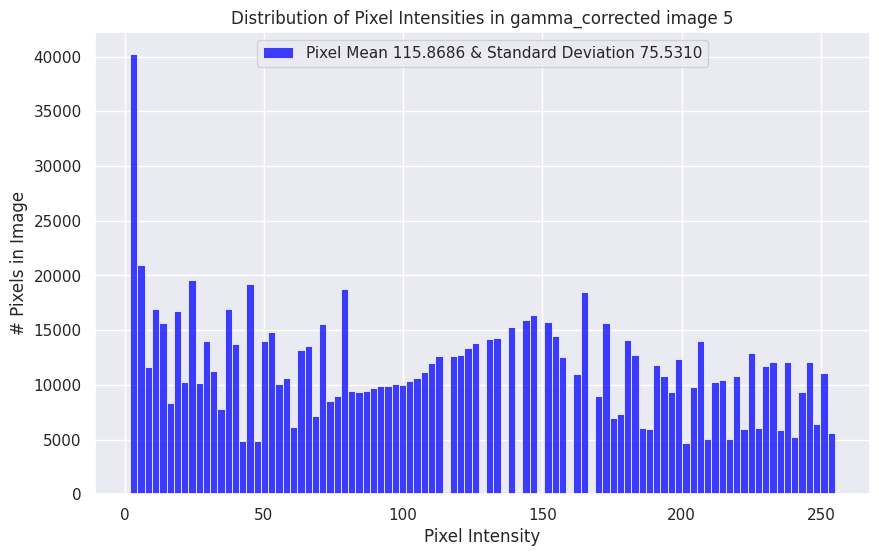

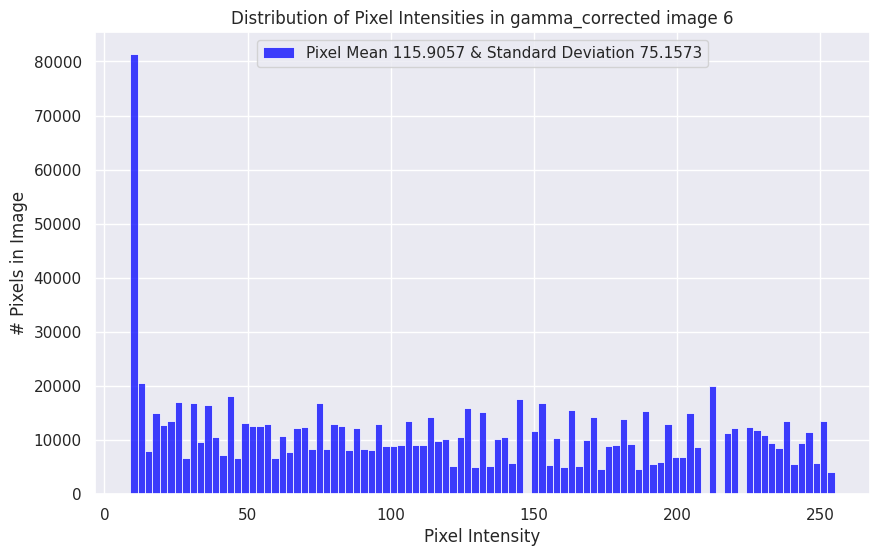

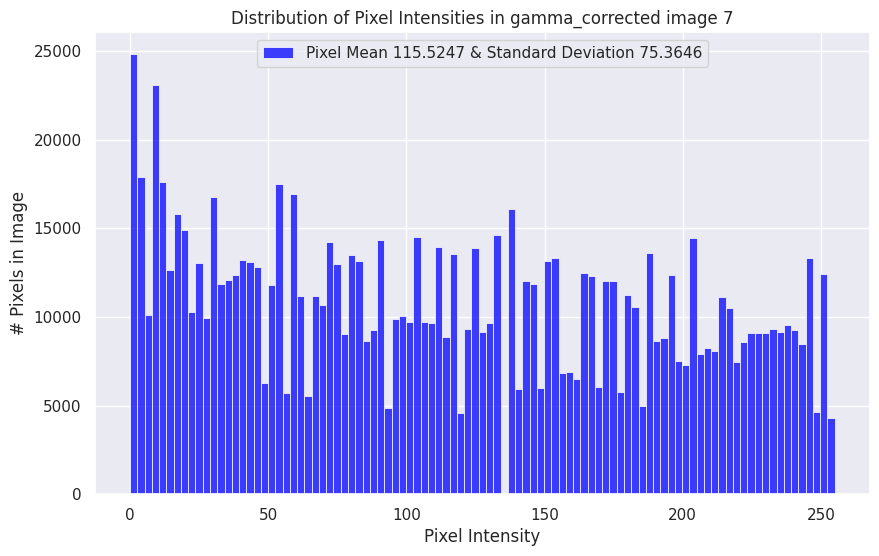

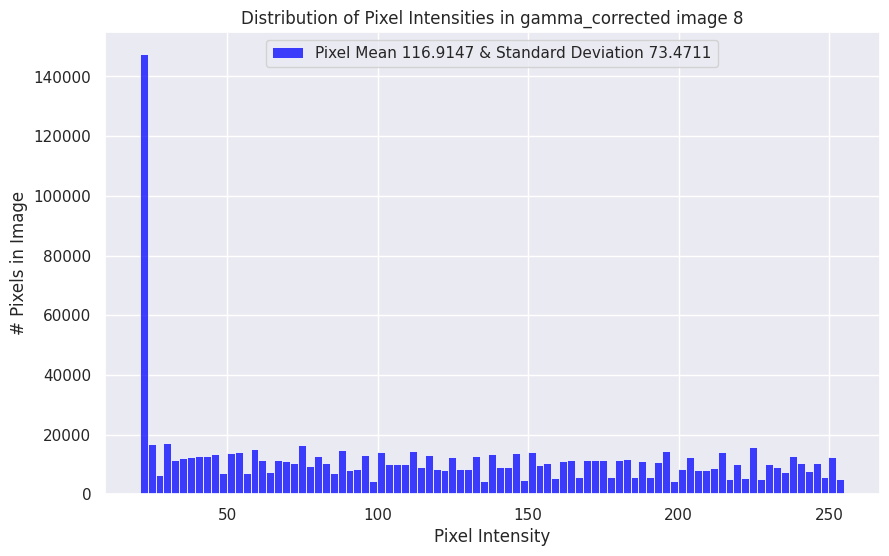

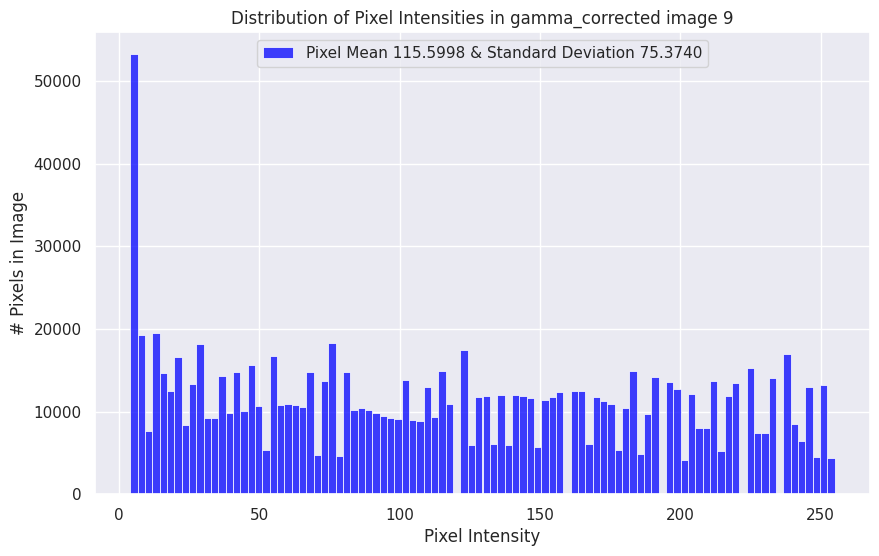

In [28]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from skimage import exposure
import os

# Görüntü dosyalarının bulunduğu dizin
img_dir = 'nih/images_small/'


def process_images_and_plot_histograms(images, img_dir):
    for i, image_name in enumerate(random_images, start=1):
        # Görüntüyü yükle
        image_path = os.path.join(img_dir, image_name)
        raw_image = plt.imread(image_path)

        # Her görüntü için min ve max değeri hesapla
        min_val, max_val = raw_image.min(), raw_image.max()

        # Adım 1: Kontrast genişletme (normalize edip [0, 255] aralığına çekiyoruz)
        contrast_stretched = (raw_image - min_val) / (max_val - min_val)  # Normalize [0, 1]
        contrast_stretched = (contrast_stretched * 255).astype(np.uint8)  # [0, 255] aralığına ölçeklendir

        # Adım 2: Kontrast eşitleme (histogram eşitleme)
        equalized_image = exposure.equalize_hist(contrast_stretched)  # [0, 1] aralığında değer döndürür
        equalized_image = (equalized_image * 255).astype(np.uint8)  # [0, 255] aralığına ölçeklendir

        # Adım 3: Gamma düzeltmesi
        gamma = 1.2  # Gamma değeri
        gamma_corrected = np.power(equalized_image / 255.0, gamma) * 255
        gamma_corrected = gamma_corrected.astype(np.uint8)

        # Görüntü histogramını çizdirme
        plt.figure(figsize=(10, 6))
        sns.histplot(gamma_corrected.ravel(),
                     label=f'Pixel Mean {np.mean(gamma_corrected):.4f} & Standard Deviation {np.std(gamma_corrected):.4f}', kde=False, color='blue')
        plt.legend(loc='upper center')
        plt.title(f'Distribution of Pixel Intensities in gamma_corrected image {i}')
        plt.xlabel('Pixel Intensity')
        plt.ylabel('# Pixels in Image')
        plt.show()

# Fonksiyonu çağır ve her görüntü için histogramları çizdir
process_images_and_plot_histograms(random_images, img_dir)

TUM GORUNTULERE EMDIAN VE GAUSSIAN BLUR UYGULAYIN

# MEDIAN VE GAUSSIAN

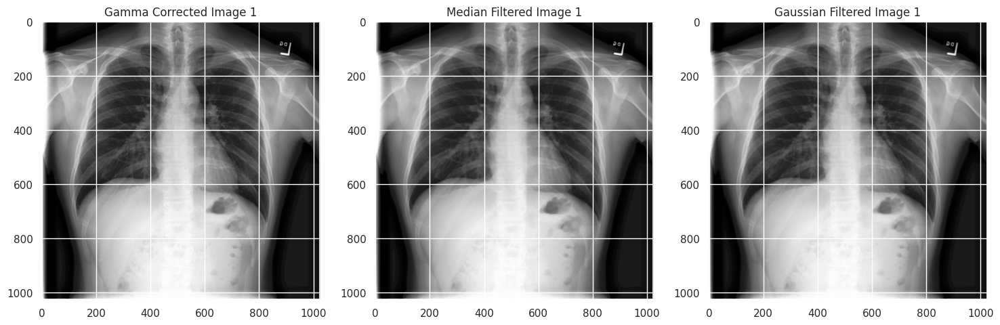

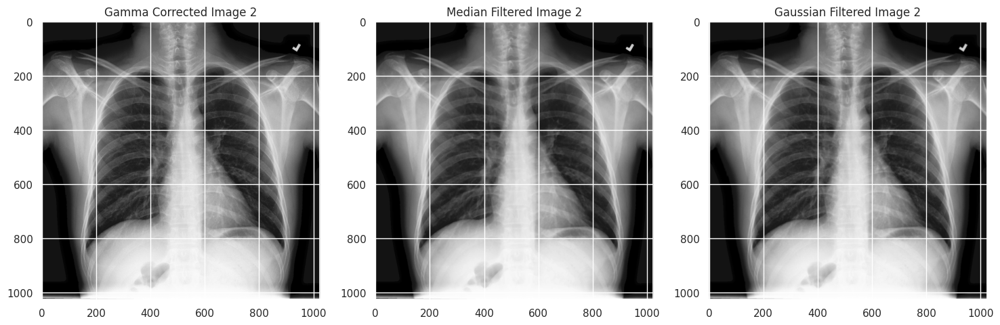

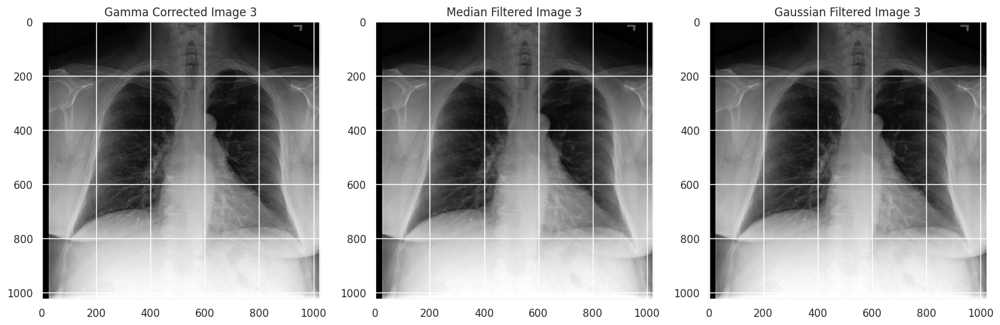

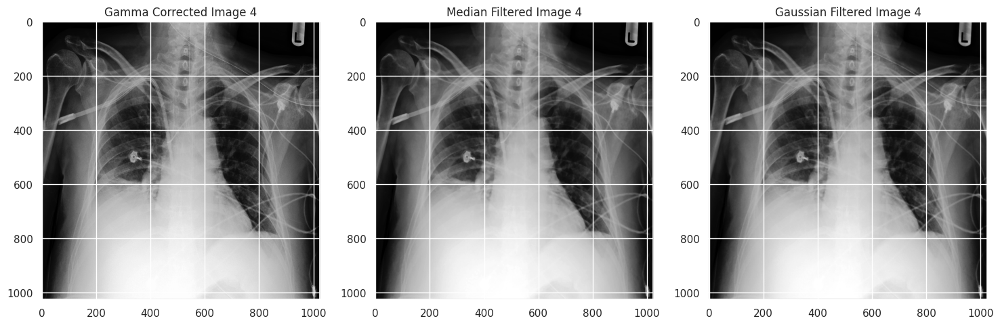

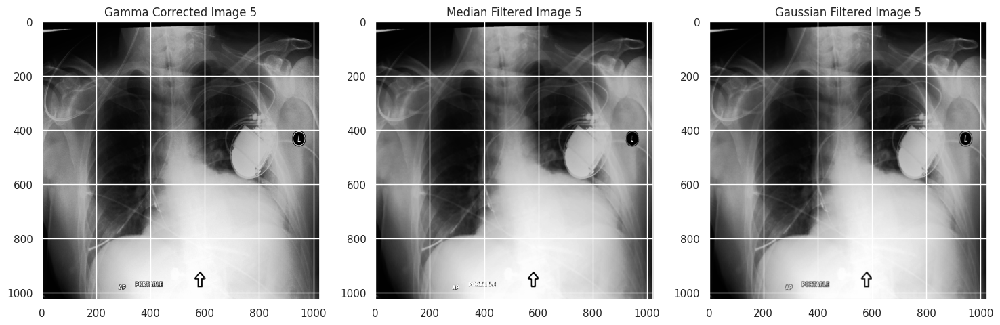

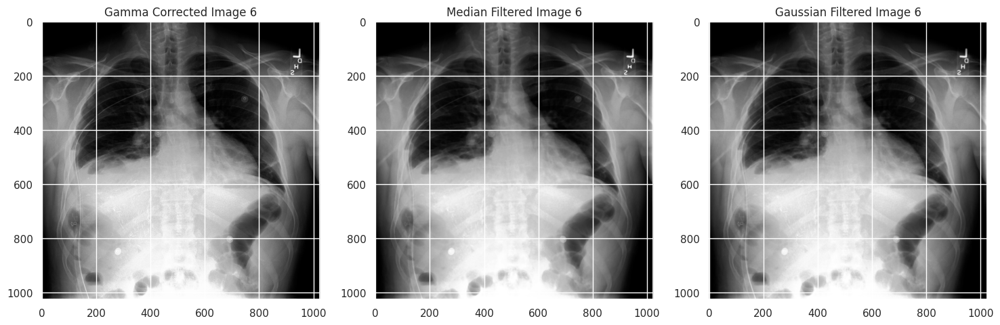

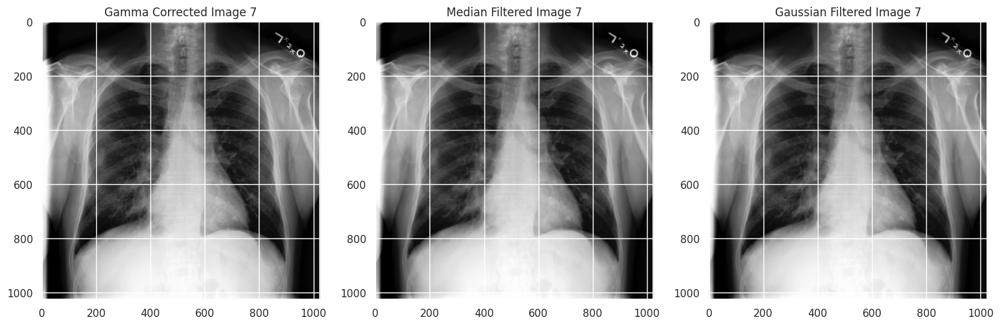

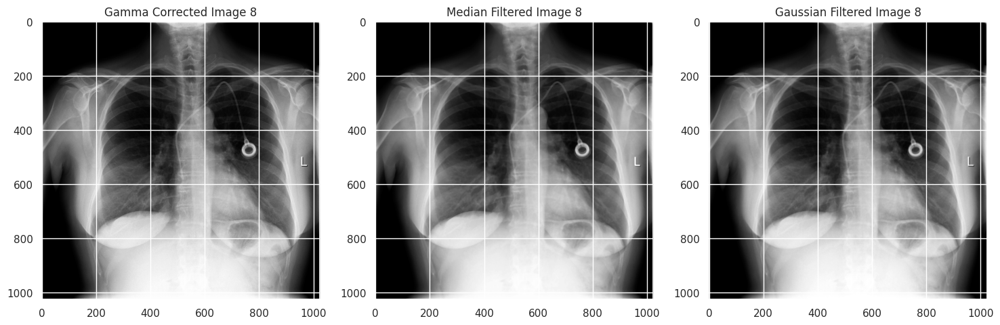

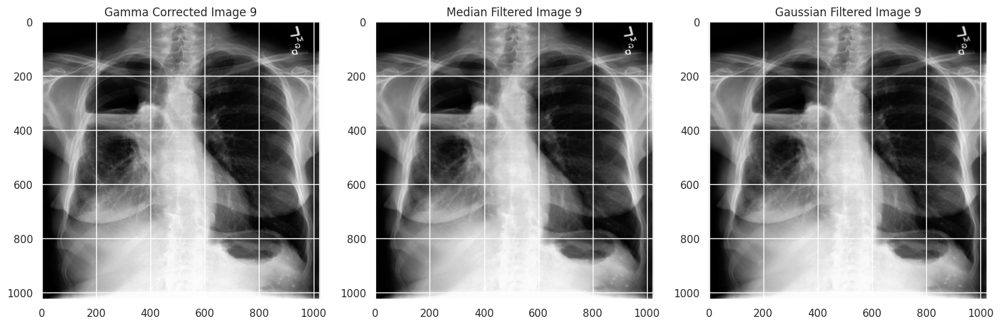

In [30]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from skimage import exposure

def process_images_and_display(random_images, img_dir, gamma=1.2):
    for i, image_name in enumerate(random_images, start=1):
        # Görüntüyü yükle
        image_path = os.path.join(img_dir, image_name)
        raw_image = plt.imread(image_path)

        # Kontrast genişletme ve gamma düzeltmesi
        min_val, max_val = raw_image.min(), raw_image.max()
        contrast_stretched = (raw_image - min_val) / (max_val - min_val) * 255
        contrast_stretched = contrast_stretched.astype(np.uint8)

        equalized_image = exposure.equalize_hist(contrast_stretched) * 255
        equalized_image = equalized_image.astype(np.uint8)

        gamma_corrected = np.power(equalized_image / 255.0, gamma) * 255
        gamma_corrected = gamma_corrected.astype(np.uint8)

        # Gaussian ve median filtreleri uygula
        median_filtered = cv2.medianBlur(gamma_corrected, 5)
        gaussian_filtered = cv2.GaussianBlur(gamma_corrected, (5, 5), 0)

        # Sonuçları yan yana görüntüle
        plt.figure(figsize=(18, 6))

        # Gamma corrected image
        plt.subplot(1, 3, 1)
        plt.imshow(gamma_corrected, cmap='gray')
        plt.title(f'Gamma Corrected Image {i}')

        # Median filtered image
        plt.subplot(1, 3, 2)
        plt.imshow(median_filtered, cmap='gray')
        plt.title(f'Median Filtered Image {i}')

        # Gaussian filtered image
        plt.subplot(1, 3, 3)
        plt.imshow(gaussian_filtered, cmap='gray')
        plt.title(f'Gaussian Filtered Image {i}')

        plt.show()

# Fonksiyonu çağır ve her görüntü için işlem ve çizimleri yap
process_images_and_display(random_images, img_dir, gamma=1.2)


Her iki filtre sonucunu yan yana görselleştirdiğimizde, median filtrenin kenarları daha iyi koruyarak keskinliği koruduğunu, Gaussian filtrenin ise genel bir yumuşama sağladığını görebiliriz. Gamma sayısındaki değişiklikler 3 görüntü için daha net ayrım sunabilir.

DERECESI RASTGELE 0 ILA 10 ARASINDA OLACAK SEKILDE ROTATION UYGULAYIN GORUNTUYE FLIPPING UYGULAYIN

# ROTATION AND FLIPPING

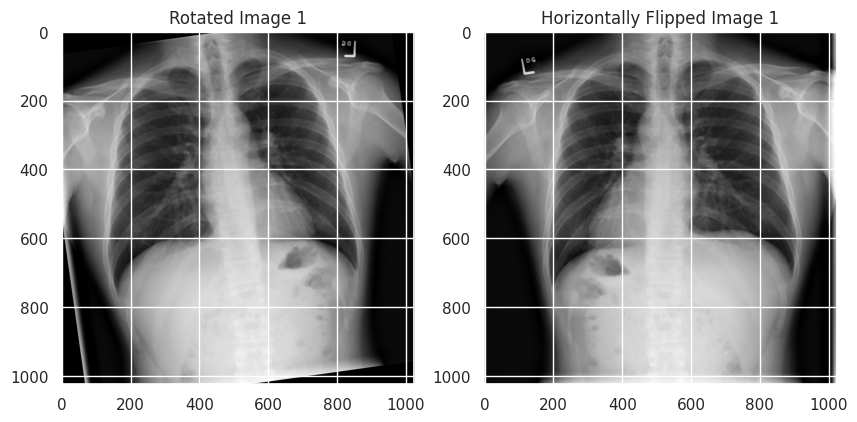

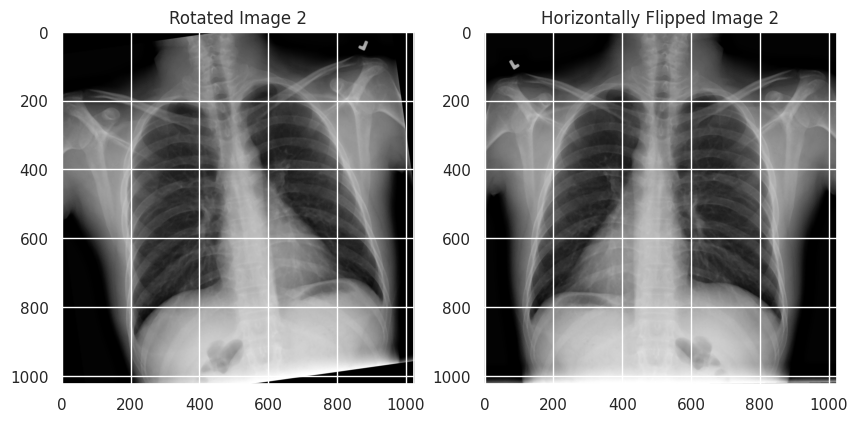

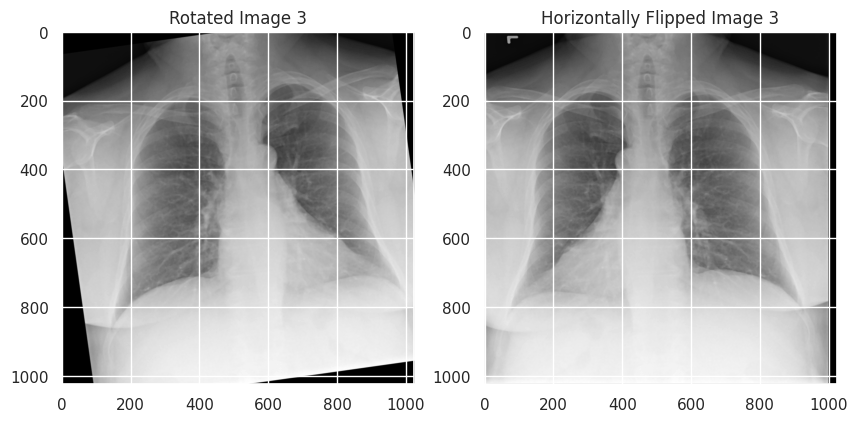

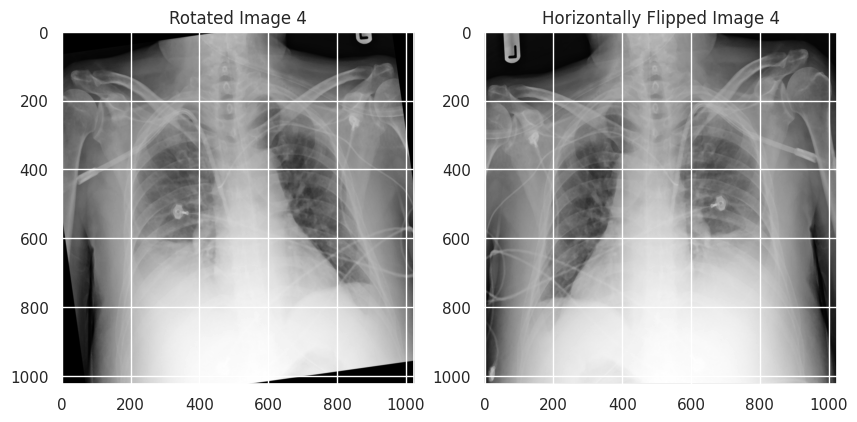

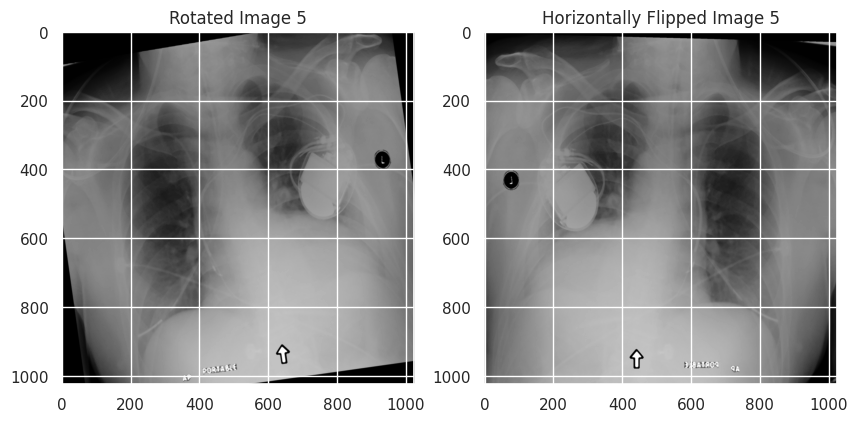

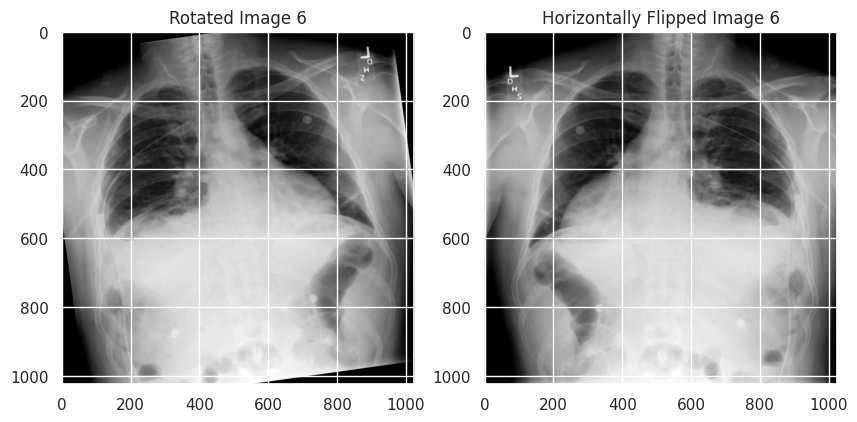

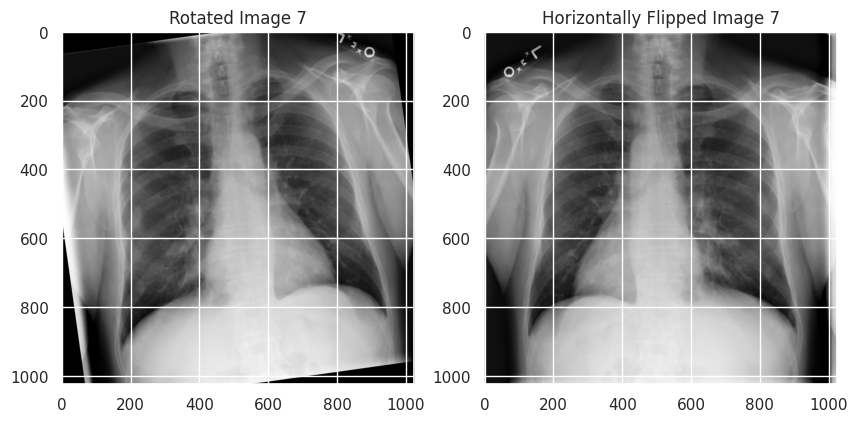

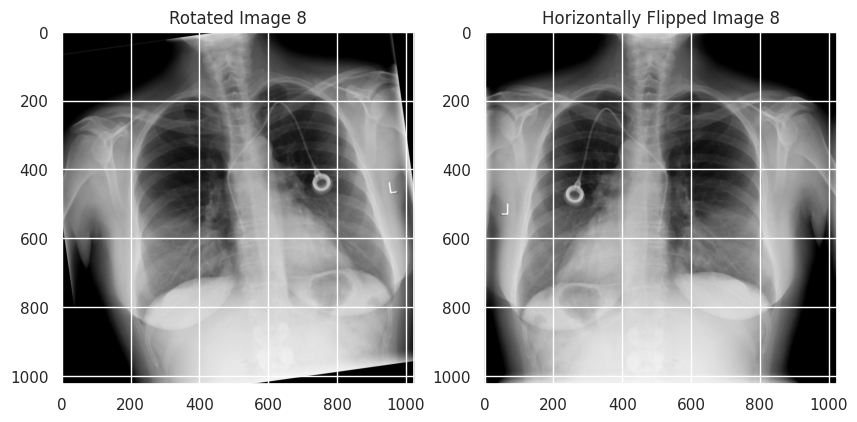

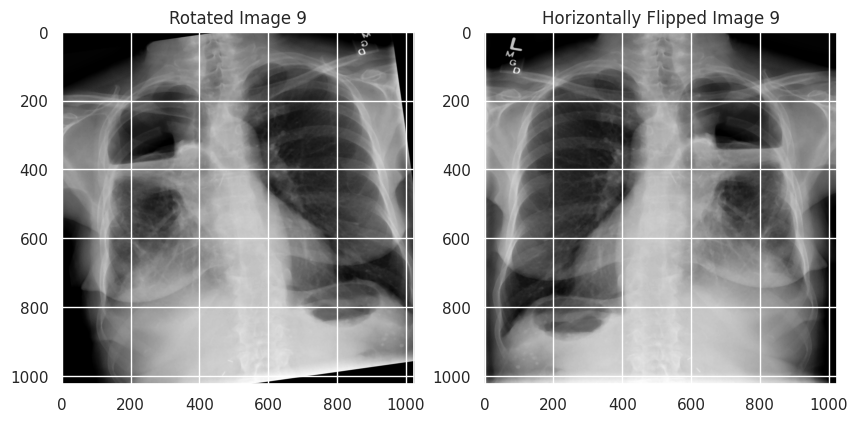

In [34]:
import cv2
import os
import matplotlib.pyplot as plt

def process_and_display_transformed_images(random_images, img_dir):
    for i, image_file in enumerate(random_images, start=1):
        # Görüntüyü yükle
        image_path = os.path.join(img_dir, image_file)
        raw_image = plt.imread(image_path)

        # Adım 1: Median filtreleme
        median_filtered = cv2.medianBlur((raw_image * 255).astype(np.uint8), 5)

        # Adım 2: 10 derece döndürme
        center = (median_filtered.shape[1] // 2, median_filtered.shape[0] // 2)
        rotation_matrix = cv2.getRotationMatrix2D(center, angle=8, scale=1.0)
        rotated_image = cv2.warpAffine(median_filtered, rotation_matrix, (median_filtered.shape[1], median_filtered.shape[0]))

        # Adım 3: Yatay çevirme
        flipped_horizontal = cv2.flip(median_filtered, 1)

        # Görüntüleri yan yana çizdirme
        plt.figure(figsize=(10, 5))
        plt.subplot(1, 2, 1), plt.imshow(rotated_image, cmap='gray'), plt.title(f"Rotated Image {i}")
        plt.subplot(1, 2, 2), plt.imshow(flipped_horizontal, cmap='gray'), plt.title(f"Horizontally Flipped Image {i}")
        plt.show()

# Fonksiyonu çağır ve her görüntü için dönüşümleri uygula
process_and_display_transformed_images(random_images, img_dir)


# Fourier Dönüşümü ve Filtreleme


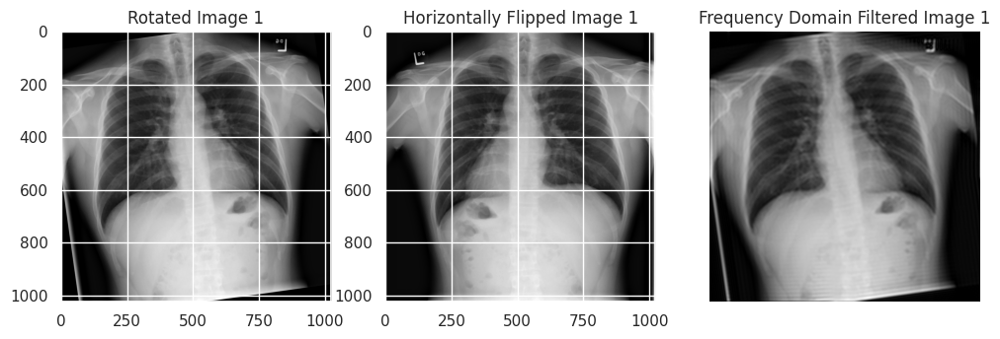

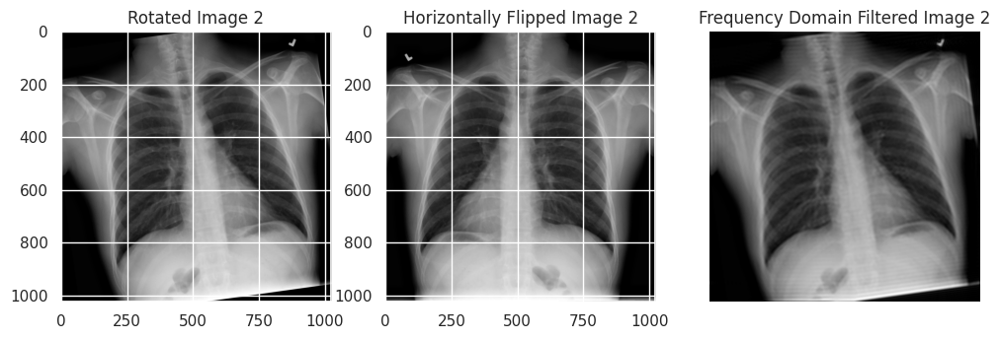

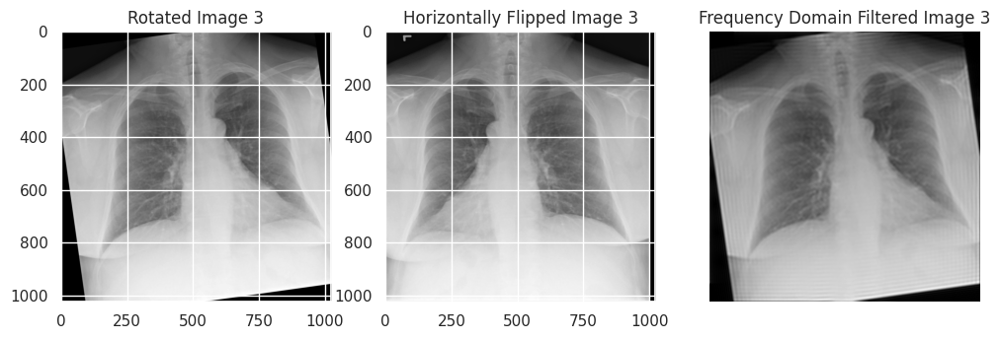

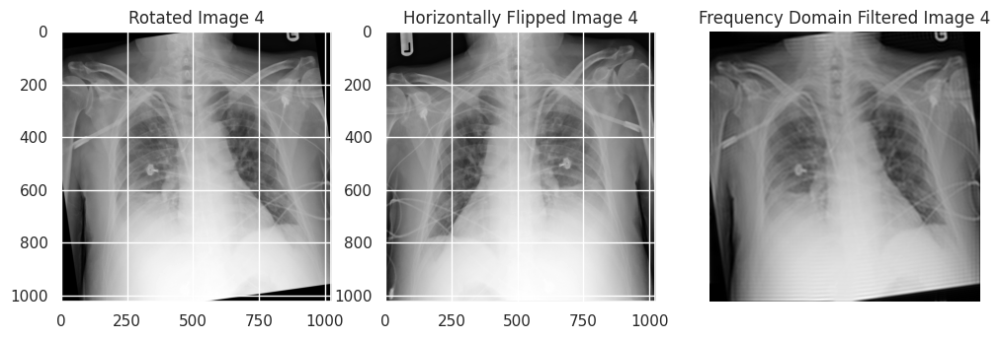

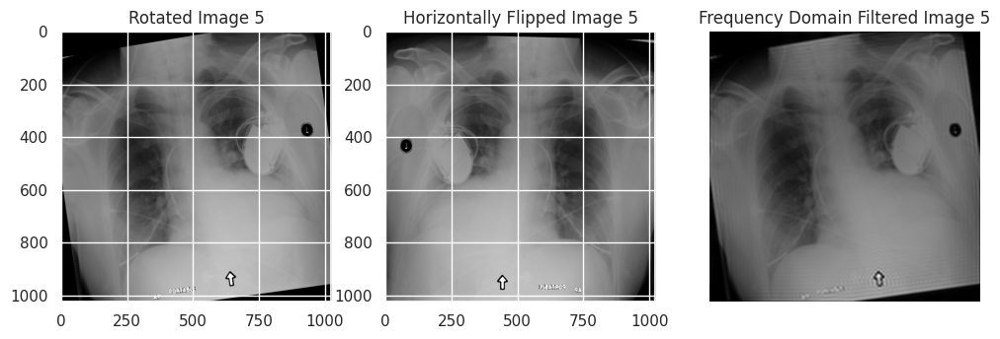

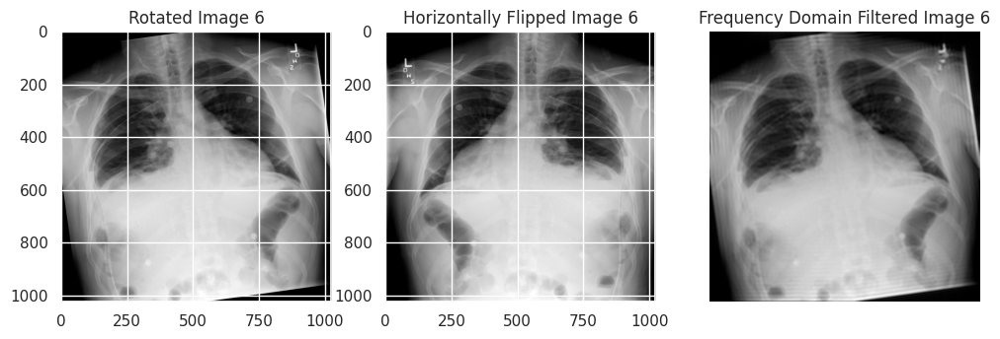

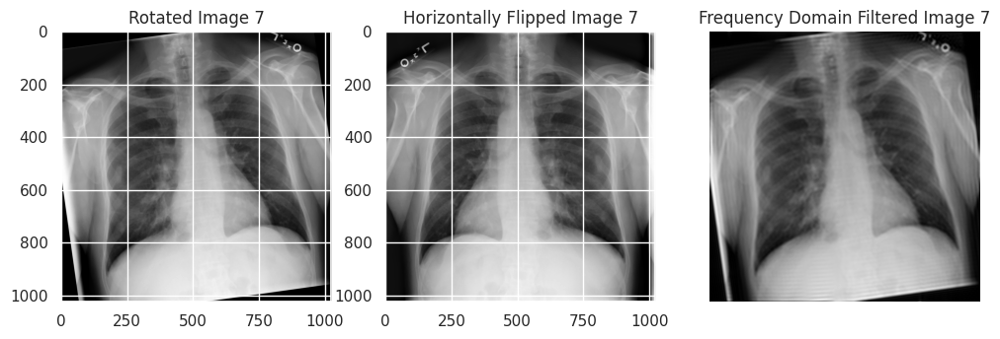

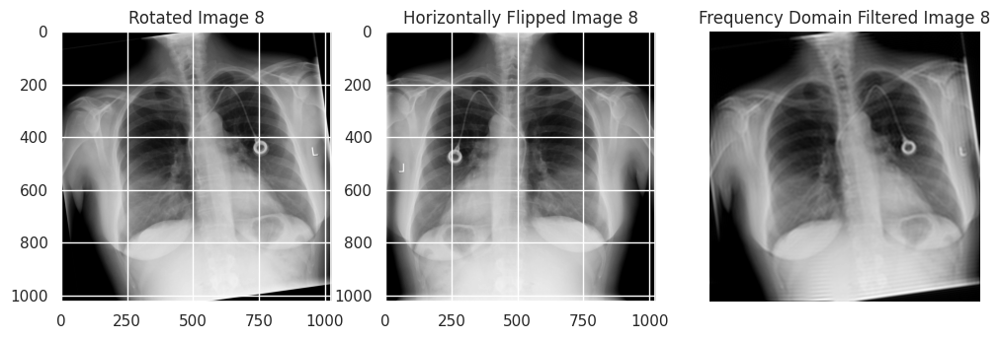

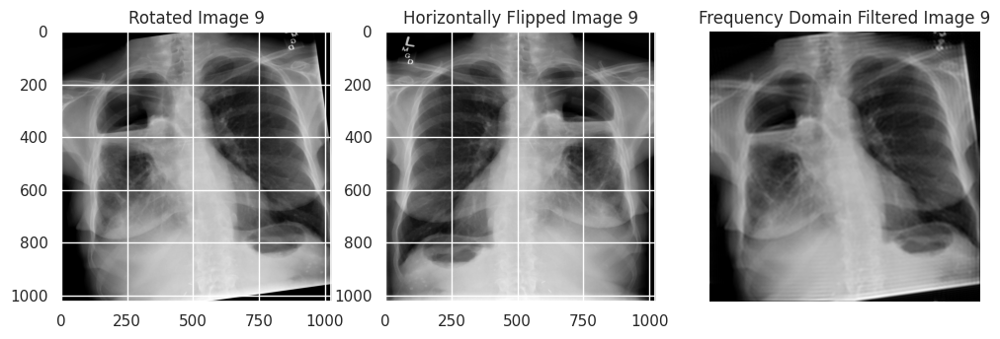

In [38]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

def process_images_with_fourier(random_images, img_dir, angle=10, mask_size=30):
    for i, image_file in enumerate(random_images, start=1):
        # Görüntüyü yükle
        image_path = os.path.join(img_dir, image_file)
        raw_image = plt.imread(image_path)

        # Median filtre uygula
        median_filtered = cv2.medianBlur((raw_image * 255).astype(np.uint8), 5)

        # Döndürme işlemi
        center = (median_filtered.shape[1] // 2, median_filtered.shape[0] // 2)
        rotation_matrix = cv2.getRotationMatrix2D(center, angle=angle, scale=1.0)
        rotated_image = cv2.warpAffine(median_filtered, rotation_matrix, (median_filtered.shape[1], median_filtered.shape[0]))

        # Yatay çevirme
        flipped_horizontal = cv2.flip(median_filtered, 1)

        # Fourier Dönüşümü ve Frekans Filtreleme
        dft = cv2.dft(np.float32(rotated_image), flags=cv2.DFT_COMPLEX_OUTPUT)
        dft_shifted = np.fft.fftshift(dft)
        rows, cols = rotated_image.shape
        crow, ccol = rows // 2, cols // 2
        mask = np.zeros((rows, cols, 2), np.uint8)
        mask[crow-mask_size:crow+mask_size, ccol-mask_size:ccol+mask_size] = 1  # Mask boyutunu belirliyor
        fshift = dft_shifted * mask
        f_ishift = np.fft.ifftshift(fshift)
        filtered_image = cv2.idft(f_ishift)
        filtered_image = cv2.magnitude(filtered_image[:, :, 0], filtered_image[:, :, 1])

        # Normalize edilmesi
        filtered_image = cv2.normalize(filtered_image, None, 0, 255, cv2.NORM_MINMAX)
        filtered_image = filtered_image.astype(np.uint8)

        # Görüntüleri yan yana gösterme
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 3, 1), plt.imshow(rotated_image, cmap='gray'), plt.title(f"Rotated Image {i}")
        plt.subplot(1, 3, 2), plt.imshow(flipped_horizontal, cmap='gray'), plt.title(f"Horizontally Flipped Image {i}")
        plt.subplot(1, 3, 3), plt.imshow(filtered_image, cmap='gray'), plt.title(f"Frequency Domain Filtered Image {i}")
        plt.axis("off")
        plt.show()

# Fonksiyonu çağır ve her görüntü için işlemleri uygula
process_images_with_fourier(random_images, img_dir, angle=8, mask_size=66)


Döndürme açısını artırarak farklı yönden incelemek mümkündür. Amaçlardan biri veriyi artırmak için bu yöntem olabilir.

Frekans alanı filtreleme, görüntüdeki detayları veya ana hatları ortaya çıkarmak için kullanılır ve detay seviyesini değiştirebilir. Bu tip filtreleme, özellikle ince detayların model için farklılıkları görmesi için iyi olabilir.

# Keskinleştirme ve Enterpolasyon

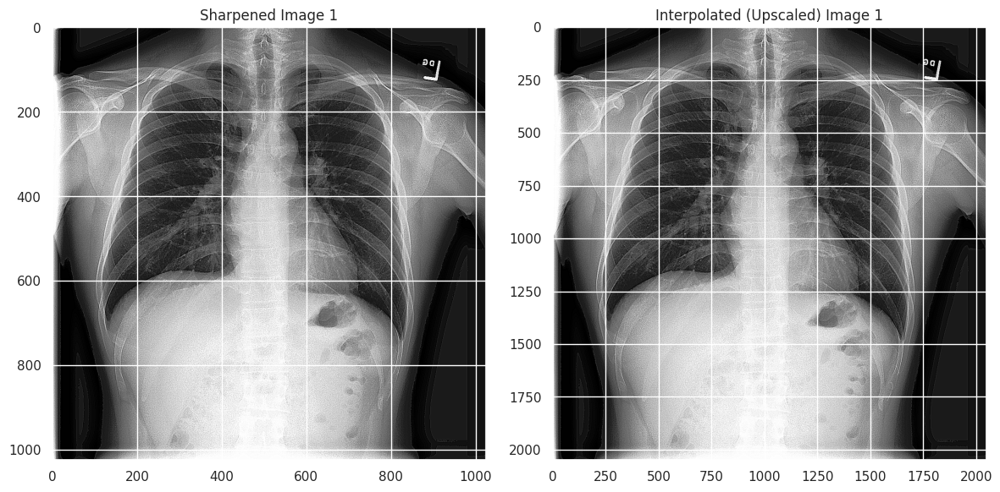

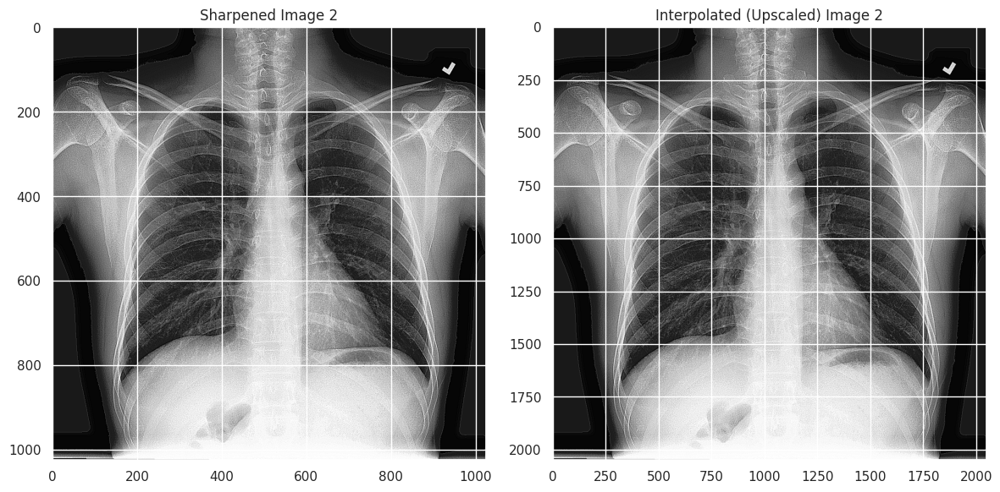

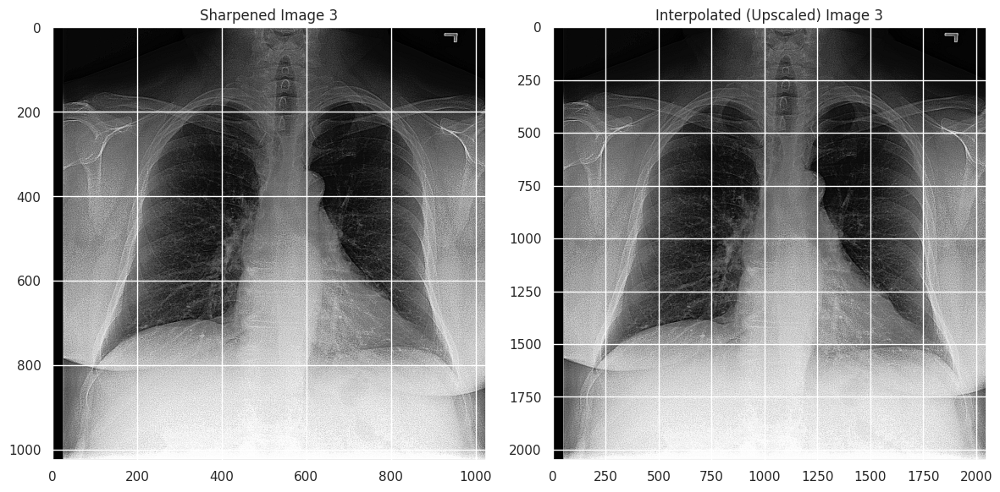

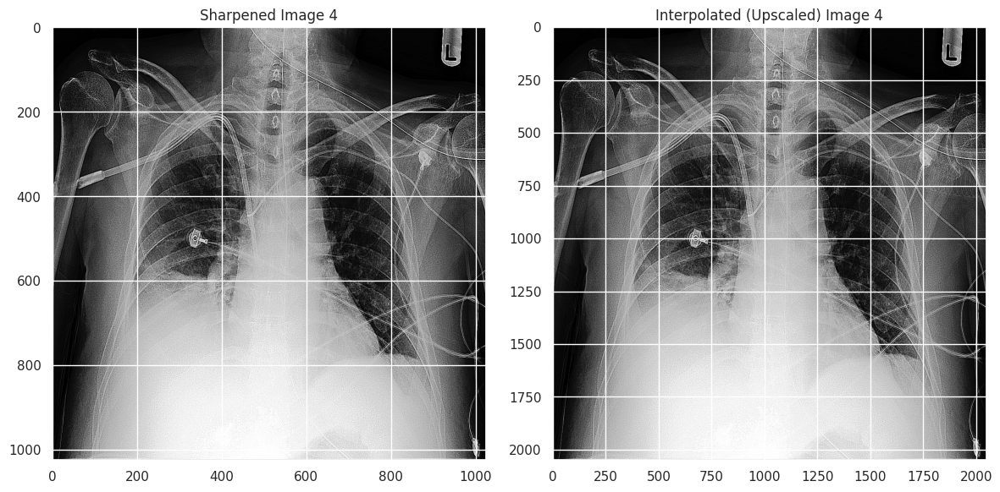

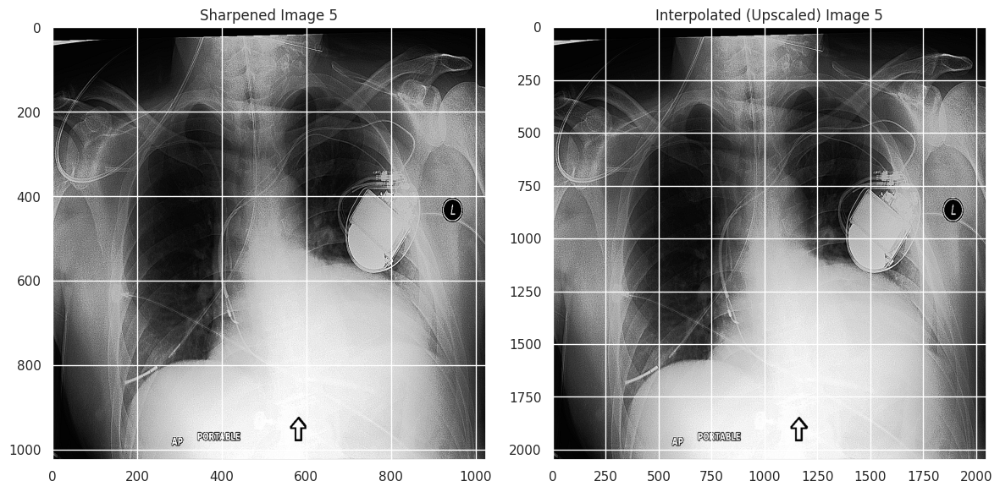

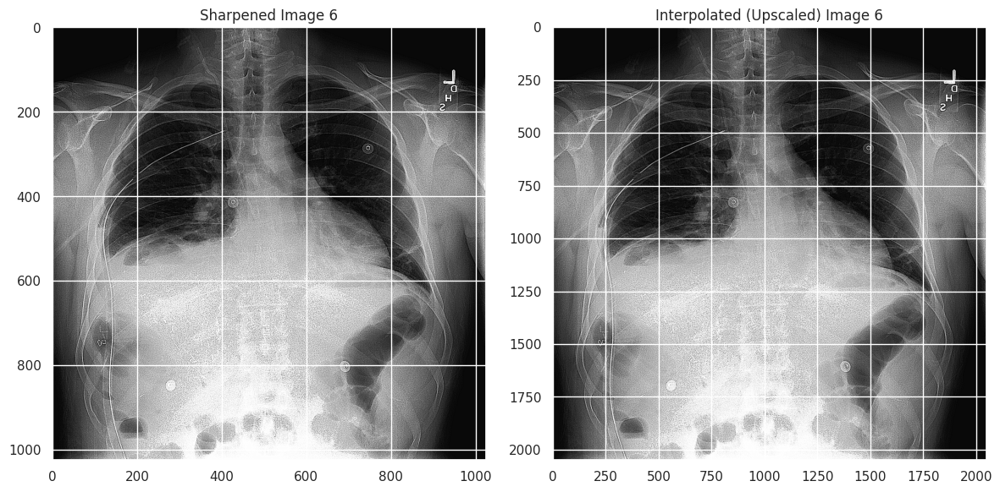

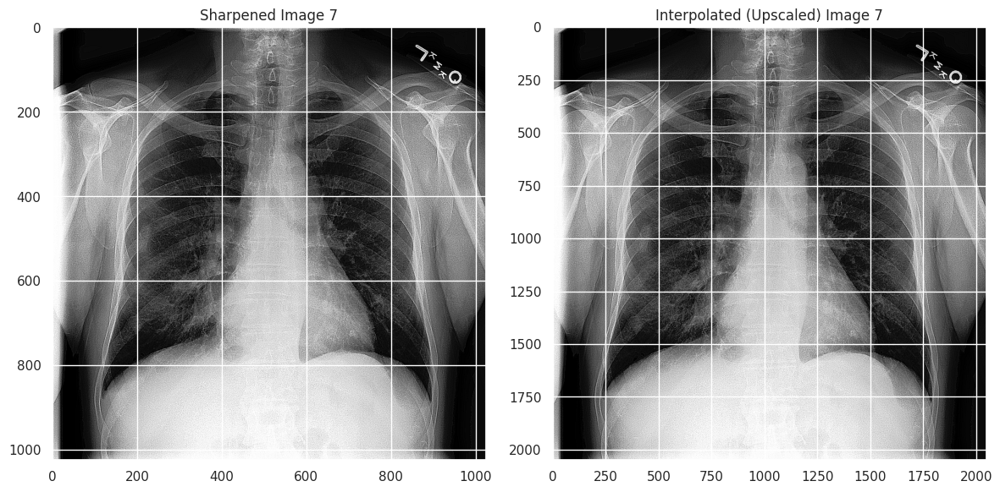

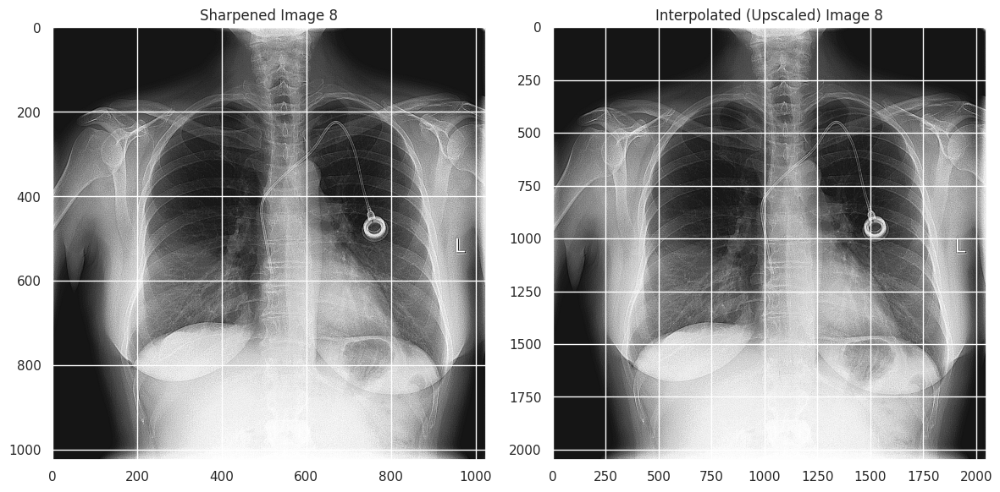

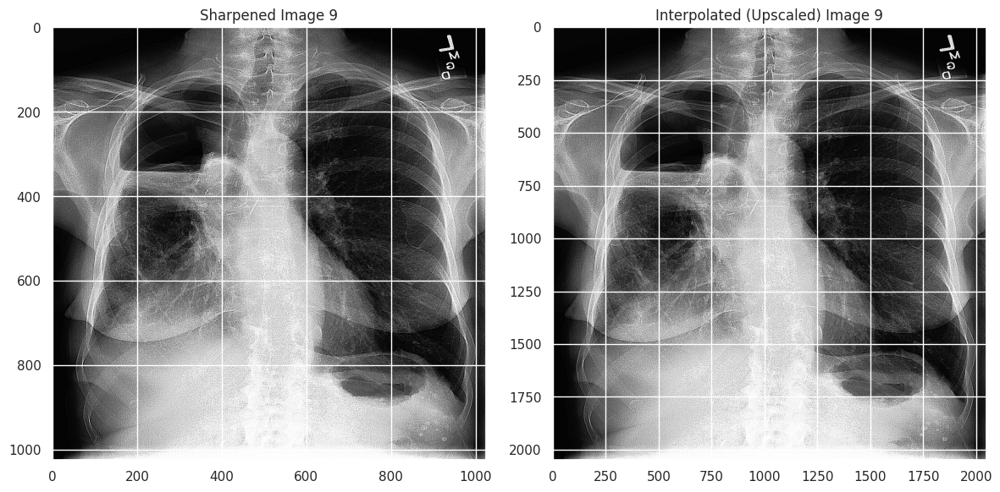

In [40]:
import numpy as np
import cv2
import os
import matplotlib.pyplot as plt
from scipy.ndimage import zoom
from skimage import exposure

def process_images_and_sharpen(random_images, img_dir, gamma=1.2):
    for i, image_name in enumerate(random_images, start=1):
        # Görüntüyü yükle
        image_path = os.path.join(img_dir, image_name)
        raw_image = plt.imread(image_path)

        # Kontrast genişletme ve gamma düzeltmesi
        min_val, max_val = raw_image.min(), raw_image.max()
        contrast_stretched = (raw_image - min_val) / (max_val - min_val) * 255
        contrast_stretched = contrast_stretched.astype(np.uint8)

        equalized_image = exposure.equalize_hist(contrast_stretched) * 255
        equalized_image = equalized_image.astype(np.uint8)

        gamma_corrected = np.power(equalized_image / 255.0, gamma) * 255
        gamma_corrected = gamma_corrected.astype(np.uint8)

        # Step 4: Apply sharpening using an unsharp masking kernel
        sharpening_kernel = np.array([[-1, -1, -1],
                                      [-1,  9, -1],
                                      [-1, -1, -1]])
        sharpened_image = np.clip(cv2.filter2D(gamma_corrected, -1, sharpening_kernel), 0, 255).astype(np.uint8)

        # Step 5: Apply bicubic interpolation to upscale the image by a factor of 2
        scale_factor = 2
        resized_image = zoom(sharpened_image, scale_factor, order=3)  # Bicubic interpolation with `order=3`

        # Visualize results
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1), plt.imshow(sharpened_image, cmap='gray'), plt.title(f"Sharpened Image {i}")
        plt.subplot(1, 2, 2), plt.imshow(resized_image, cmap='gray'), plt.title(f"Interpolated (Upscaled) Image {i}")

        plt.tight_layout()
        plt.show()

# Fonksiyonu çağır ve her görüntü için keskinleştirme ve enterpolasyon işlemlerini görselleştir
process_images_and_sharpen(random_images, img_dir)


Keskinleştirme işlemi, bazı görüntülerin kenarlarını daha belirgin hale getirdi. Bazı görüntüdeki detaylar daha netleşti, ancak çok keskinleştirilmiş bir görüntüde gürültü olarakta görebiliriz. Yani, keskinleştirme, görüntüdeki ayrıntıları iyileştiriyor ancak optimizasyonu yapılmalı dikkatli seçilmelidir.

Bu iki işlem, görsellerdeki netliği artırmak ve çözünürlüklerini iyileştirmek için yaygın olarak kullanılır ve modellerimiz için veri artırma için faydalı olabilir.

1. Rastgele Görüntülerin İstatistiksel Özelliklerini Hesaplama (Max, Min, Std)
İlk olarak, her bir görüntü için maksimum, minimum, ortalama ve standart sapma değerlerini hesapladım. Bu değerler, görüntülerin genel özellikleri hakkında fikir verdi. Standart sapma değerlerinin büyük olduğunu görmek, görüntülerdeki pikseller arasında yüksek bir değişkenlik olduğunu ve dolayısıyla bazı görüntülerde daha fazla detay olduğunu ima ediyordu.

2. Histogram Çizimi
Görüntülerin histogramlarını incelediğimde, çoğu görüntüde piksel yoğunluğunun genellikle geniş bir aralığa yayılmadığını fark ettim. Bazı görüntülerde, piksel yoğunluğu sıkışmış ve çok fazla düşük veya çok yüksek değere sahipti. Bu, özellikle kontrast germe işlemi için bir neden oluşturdu, çünkü kontrastı artırmak görüntülerin daha net ve belirgin hale gelmesini sağlayabilir bence.

3. Kontrast Germe (Stretching)
Minimum ve maksimum piksel değerlerini kullanarak yaptığım kontrast germe işlemi, bazı görüntülerde net bir fark yaratmadı. Çünkü zaten başlangıçta yeterli kontrasta sahip olan görüntülerde fazla değişiklik gözlenmedi. Ancak, bazı görüntülerde kontrastın artırılması küçükte olsa değişiklikleri ortaya çıktı.

4. Histogram Eşitleme (Equalization)
Eşitleme, özellikle düşük kontrastlı alanlarda daha belirgin hale geldi ve X-Ray görüntülerinin aydınlık seviyesininde biraz arttığını gördüm. Detaylıca incelenmesi gereken yerlerin daha fazla detayı ortaya çıkartılabilir ve gölgelerdeki belirginlik arttırılabilir.

5. Gamma Düzeltme
Gamma düzeltmesi uygulayarak parlaklık seviyelerini ayarladım. Bu işlem, daha önce kontrastı düşük olan bazı görüntülerde parlaklık artırarak daha canlı ve görsel olarak çekici hale getirdi. Ancak bazı görüntülerde bu işlem aşırı parlaklığa yol açtı, bu yüzden gamma değeri dikkatle seçilmeli. Genelde, gamma değeri çok yüksek olduğunda aşırı parlak görüntülerle karşılaştım.

6. Median ve Gaussian Blur Uygulama
Gamma düzeltilmiş görüntüler üzerinde median ve Gaussian blur filtrelerini uyguladım. Median blur, röntgen görüntüsündeki gürültüleri az da olsa gidererek daha pürüzsüz bir görünüm sağladı, fakat bu işlem bazı detayları kaybettirdiğinide gözlemledim. Gaussian blur ise daha yumuşak bir bulanıklık sağladı ve görüntüdeki düşük frekansları hafifçe yumuşatarak daha doğal bir sonuç verdi. Bu iki işlem arasındaki farkları gözlemlediğimde, Gaussian blur'ın daha doğal bir etki yarattığını düşündüm, ancak median blur, gürültüye karşı daha etkiliydi.

7. Görüntü Döndürme ve Yatay Çevirme
Görüntüleri 8 derece arasında döndürdüm ve yatay çevirme işlemi uyguladım. Ancak, görsellik açısından çok fazla farklılık yaratmadı. Ben büyük bir farkı yakalayamadım. Tabi model için bu özellikleri kullanmak model için etkili olabilir.

8. Fourier Dönüşümü ve Filtreleme
Fourier dönüşümü ile görüntüyü frekans alanına çevirdim ve düşük frekansları geçiren bir maske uyguladım. Düşük frekansları geçiren maske, genellikle görüntünün daha yumuşak ve az detaylı olmasına neden oldu. Ters Fourier dönüşümü ile filtreleme işlemi yaptıktan sonra, görüntülerde belirgin bir yumuşama gördüm. Bu işlem, daha pürüzsüz, daha az gürültülü bir görüntü ortaya çıkardı. Bu filtrelerde değişiklikler yaptığımda görüntülerde detay kaybı yaşanıyor o yüzden optimum halini seçmek önemli.

9. Keskinleştirme (Unsharp Masking)
Röntgen görüntülerinde kenarları belirginleştirerek bazı fotoğraflar için daha net bir görünüm sağladı. Dikkat edilmesi gereken bir diğer şey de, değişiklikler yaptığımda aşırı keskinleştirmenin görüntüyü doğal olmayan bir hale getirebilmesiydi. Miktar değiştirilerek model üzerinde etkilerini ayrıca gözlemlemek gerekli.

10. Enterpolasyon (Büyütme)
Son olarak, keskinleştirilmiş görüntüleri iki kat büyüttüm ve enterpolasyon uyguladım. Büyütme işleminde, özellikle bicubic enterpolasyon kullandığımda, görüntüde çözünürlük artışı sağladım.

Genel olarak;
Bu çalışmada, görüntülerin her biri üzerinde çok sayıda işlem gerçekleştirdim. Görüntülerin kontrastlarını, parlaklıklarını, keskinliklerini ve çözünürlüklerini iyileştirdim. Ancak her işlemde dikkat edilmesi gereken noktalar vardı. Örneğin, keskinleştirme ve büyütme işlemleri bazen istenmeyen etkiler yaratabiliyor. Diğer yandan, gamma düzeltme ve histogram eşitleme gibi işlemler, özellikle düşük kontrastlı görüntülerde detay çıkarmak için etkili olabilir. Sonuç olarak, bu tür görsel iyileştirmeler, görüntülerin daha net ve daha ayrıntılı hale gelmesini sağlayabilir, ancak her işlemde dengeyi bulmak önemli. Dengeyi bulduktan sonra model üzerinde etkilerinide inceleyebiliriz.